<h2>2<sup>η</sup> ΕΡΓΑΣΤΗΡΙΑΚΗ ΑΣΚΗΣΗ</h2>
<h3>Ανάλυση Κοινωνικής Δομής σε Τεχνητές και Πραγματικές Σύνθετες Τοπολογίες Δικτύων</h3>
<p style=text-align:justify>Στην παρούσα άσκηση θα αναλυθούν τεχνητές και πραγματικές τοπολογίες σύνθετων δικτύων με βάση τις μετρικές που χρησιμοποιήθηκαν στην προηγούμενη άσκηση και κάποιες τεχνικές που έχουν ως στόχο την εύρεση κοινωνικής δομής. Συγκεκριμένα, θα χρησιμοποιηθούν και θα συγκριθούν διάφοροι αλγόριθμοι εντοπισμού κοινοτήτων σε γράφους δικτύων που προκύπτουν από πραγματικά δεδομένα καθώς και στους συνθετικούς γράφους της πρώτης εργαστηριακής άσκησης.</p>

In [101]:

import matplotlib
import networkx as nx
import random
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
from sklearn.cluster import SpectralClustering




<h3>Α. Μελέτη πραγματικών τοπολογιών</h3>
<p style=text-align:justify>Στο παρόν ερώτημα θα μελετήσετε και θα αποκτήσετε αίσθηση της τοπολογικής δομής πραγματικών δικτύων. Πιο συγκεκριμένα, για τις τοπολογίες που φαίνονται στον <b>πίνακα 1</b>, να βρεθούν και να δειχθούν:</p>
<ol>
    <li>Η κατανομή του βαθμού κόμβου και ο μέσος βαθμός κάθε τοπολογίας.</li>
    <li>Η κατανομή του συντελεστή ομαδοποίησης κόμβου και ο μέσος συντελεστής ομαδοποίησης κάθε τοπολογίας.</li>
    <li>Η κατανομή της κεντρικότητας εγγύτητας και η μέση κεντρικότητα εγγύτητας κάθε τοπολογίας.</li>
</ol>
<p style=text-align:justify>Να συγκριθούν τα αποτελέσματα σε σχέση με αυτά των συνθετικών τοπολογιών. Να χαρακτηρίσετε τον τύπο κάθε μίας από τις πραγματικές τοπολογίες με βάση τους τύπους δικτύων που εξετάστηκαν στην πρώτη εργαστηριακή άσκηση.</p>

<table style=width:100%>
    <caption>Πίνακας <b>1</b>: Πραγματικές τοπολογίες</a></caption>
<tr>
    <th style=text-align:left>Τοπολογία</th>
    <th style=text-align:left>Αρχείο</th>
    <th style=text-align:left>Περιγραφή</th>
</tr>
<tr>
    <td style=text-align:left>American College Football</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/football.zip'>football.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>football.gml</b> contains the network of American football games between Division IA colleges during regular season Fall 2000, as compiled by M. Girvan and M. Newman. The nodes have values that indicate to which conferences they belong.</p>
    </td>
</tr>  
<tr>
    <td style=text-align:left>Game of Thrones - season 5</td>
    <td style=text-align:left><a style=text-decoration:none href='https://networkofthrones.wordpress.com/the-series/season-5/'>GoT</a></td>
    <td style=text-align:left><p style=text-align:justify> The season 5 <b>GoT</b> network represents the interactions between the characters of Game of Thrones in season 5. The season 5 network has 118 nodes (characters) and 394 weighted edges, corresponding to 5,139 interactions. Data can be found here: <a style=text-decoration:none href='https://raw.githubusercontent.com/mathbeveridge/gameofthrones/master/data/got-s5-edges.csv'>GoT_data</a></p>
</tr> 
<tr>
    <td style=text-align:left>email-Eu-core</td>
    <td style=text-align:left><a style=text-decoration:none href='https://snap.stanford.edu/data/email-Eu-core.html'>email-eu-core</a></td>
    <td style=text-align:left><p style=text-align:justify> The network <b>email-Eu-core</b> was generated using email data from a large European research institution. There is an edge (u, v) in the network if person u sent person v at least one email. The e-mails only represent communication between institution members (the core) and the dataset does not contain incoming messages from or outgoing messages to the rest of the world. The dataset also contains "ground-truth" community memberships of the nodes. Each individual belongs to exactly one of 42 departments at the research institute. </p>
</tr> 
    
</table>

<h4>Παραγωγή συνθετικών τοπολογιών</h4> 
<p>Προσοχή! Τα δίκτυα που θα παράξετε θα πρέπει να είναι συνδεδεμένα.</p>

In [102]:
n=80
d=4
M=300
R=0.25
p=0.3
k=4
seedno=5
random.seed(seedno)

REG = nx.watts_strogatz_graph(n,d,0,seed=seedno)
RGER = nx.gnm_random_graph(n,M,seed=seedno)
RGG = nx.random_geometric_graph(n, R,seed=seedno)
RG_Gilbert =  nx.gnp_random_graph(n,p,seed=seedno)
SF = nx.barabasi_albert_graph(n,d,seed=seedno)
SW = nx.watts_strogatz_graph(n,d,p,seed=seedno)




<h4>Εισαγωγή και οπτικοποίηση πραγματικών τοπολογιών.</h4>

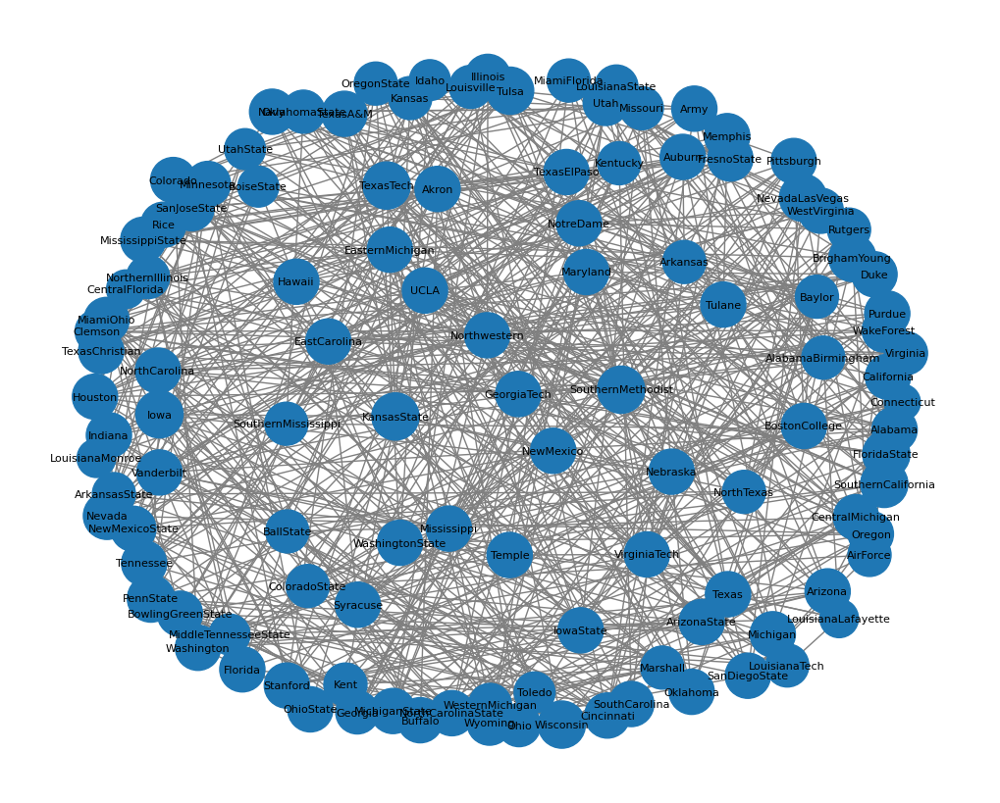

In [103]:
#football network
football=nx.read_gml("./datasets/football.gml")

# draw the graph with node_size proportional to the degree of the node
plt.figure(figsize=(10,8))
nx.draw(football, node_size=[v * 100 for v in dict(football.degree()).values()], with_labels=True,font_size=8, node_color='#1f77b4', edge_color='grey', pos=nx.spring_layout(football, k=2))
plt.show()



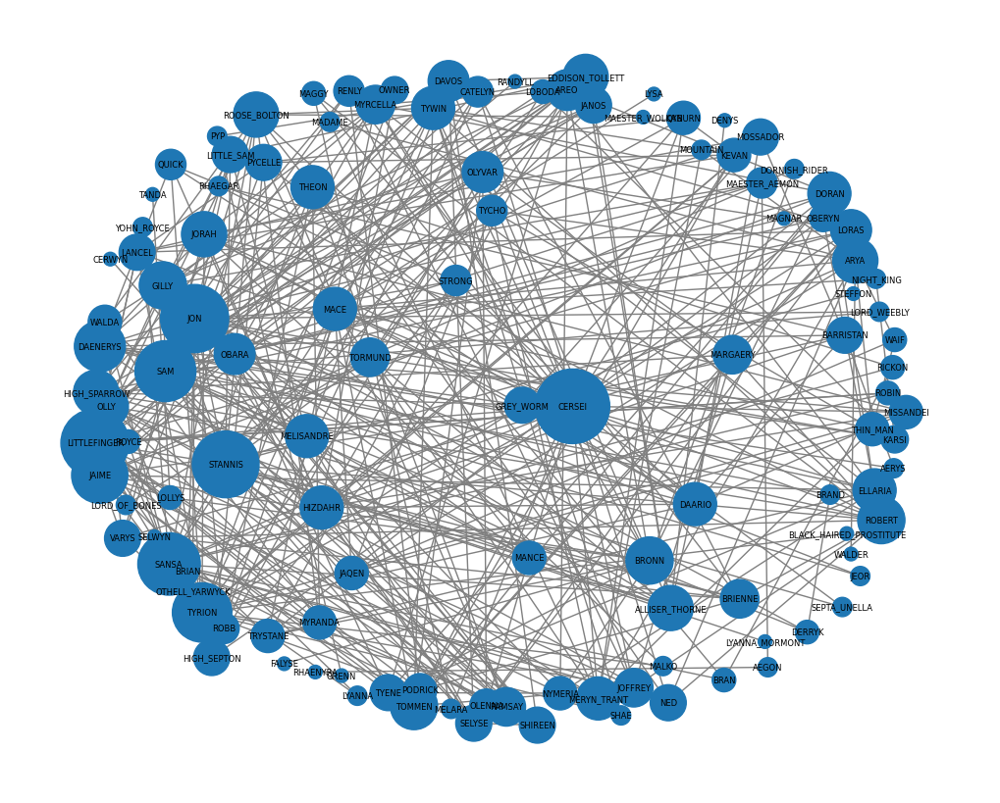

In [104]:
#Game of thrones network
import csv
got=nx.Graph()
with open('./datasets/got_s5.csv') as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    line_count = 0
    next(csv_reader)
    for row in csv_reader:
        got.add_edge(row[0],row[1])
        line_count += 1

# draw the graph with the spring layout
plt.figure(figsize=(10,8))
nx.draw(got, node_size=[v * 100 for v in dict(got.degree()).values()], with_labels=True,font_size=6, node_color='#1f77b4', edge_color='grey', pos=nx.spring_layout(got, k=2))
plt.show()


#### Προσοχή! Θα μελετήσετε τη μεγαλύτερη συνδεδεμένη συνιστώσα του δικτύου email-Eu-core, αφού πρώτα αφαιρέσετε τα self-loops. Μπορείτε να κάνετε χρήση των συναρτήσεων connected_components, subgraph, remove_edges_from του networkx.

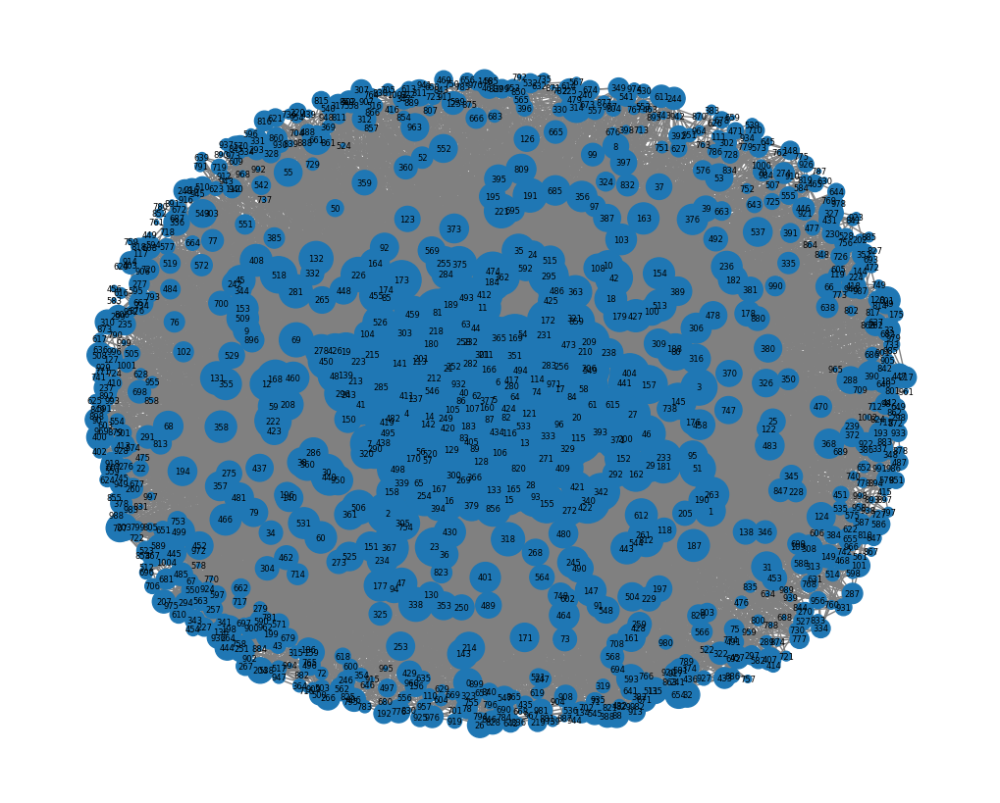

In [105]:
#email-Eu-core network
eu=nx.read_edgelist("./datasets/email-Eu-core.txt",create_using=nx.Graph())
# remove self loops
eu.remove_edges_from(nx.selfloop_edges(eu))
# find all the connected components
cc = nx.connected_components(eu)
# find the largest connected component
largest_cc = max(cc, key=len)
# create a subgraph of the largest connected component
eu = eu.subgraph(largest_cc)
# draw the graph with the spring layout
plt.figure(figsize=(10,8))
nx.draw(eu, node_size=[v * 10 for v in dict(eu.degree()).values()], with_labels=True,font_size=6, node_color='#1f77b4', edge_color='grey', pos=nx.spring_layout(eu, k=1.1))
plt.show()



<h4>Μελέτη βαθμού κόμβου για πραγματικές και συνθετικές τοπολογίες.</h4>

Average degree of Football is 10.660870


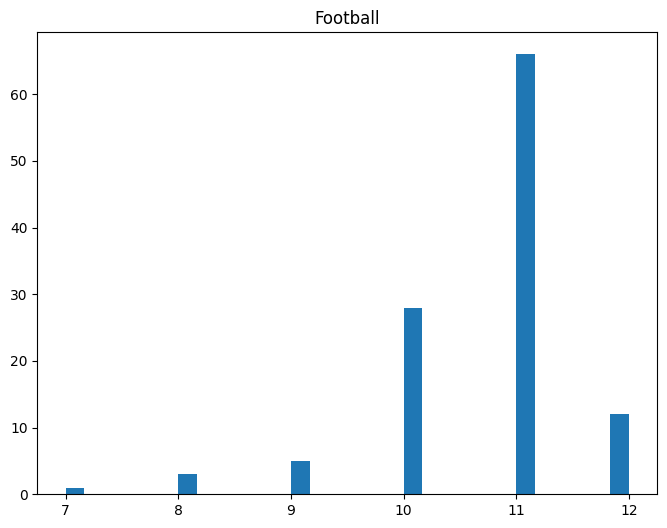

Average degree of Game of Thrones is 6.655462


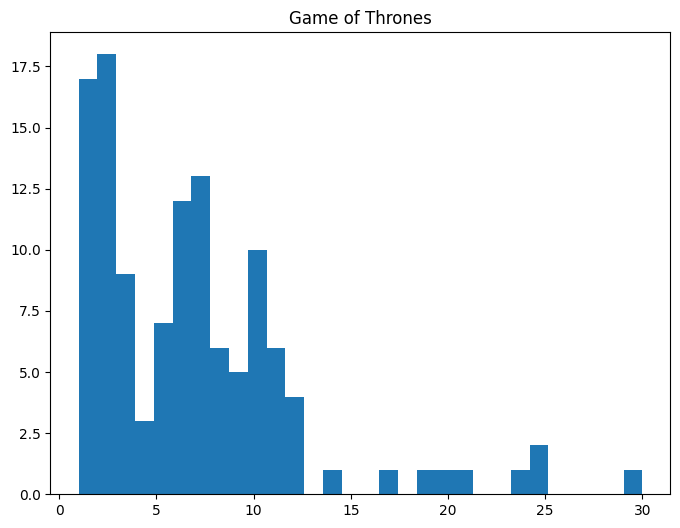

Average degree of email-Eu-core is 32.584178


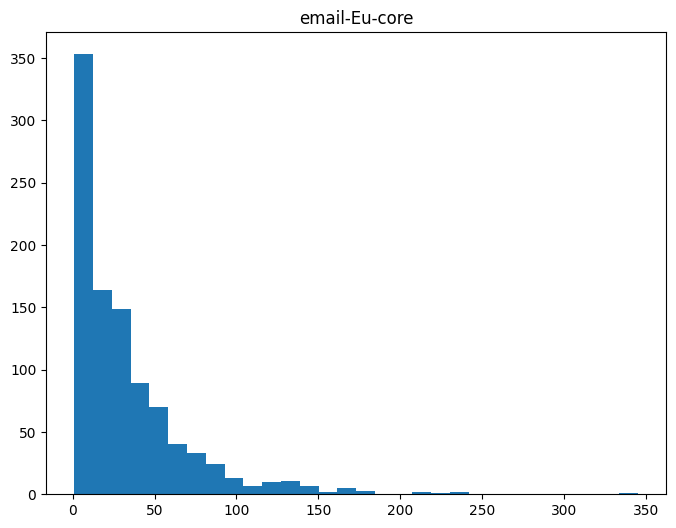

In [106]:
# show the distribution of the degrees for each topology and find the average degree

# topologies = [REG,RGER,RGG,RG_Gilbert,SF,SW,football,got,eu]
# topology_names = ["Regular","Erdos-Renyi","Random Geometric","Random Gilbert","Scale Free","Small World","Football","Game of Thrones","email-Eu-core"]

topologies = [football,got,eu]
topology_names = ["Football","Game of Thrones","email-Eu-core"]

for i in range(len(topologies)):
    print("Average degree of %s is %f" % (topology_names[i],np.mean(list(dict(topologies[i].degree()).values()))))
    plt.figure(figsize=(8,6))
    plt.hist(list(dict(topologies[i].degree()).values()),bins=30)
    plt.title(topology_names[i])
    plt.show()



<h4>Μελέτη συντελεστή ομαδοποίησης για πραγματικές και συνθετικές τοπολογίες</h4>

Average clustering coefficient of Football is 0.403216


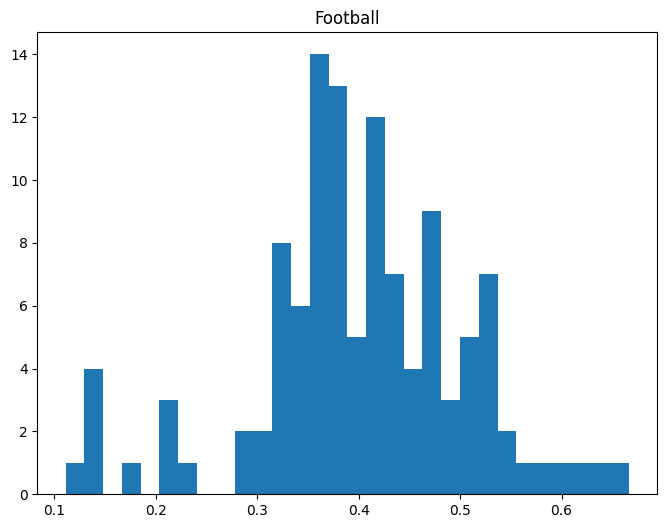

Average clustering coefficient of Game of Thrones is 0.574404


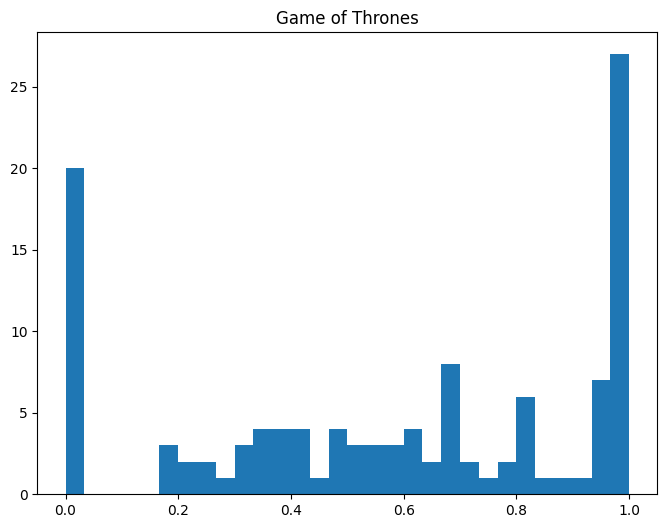

Average clustering coefficient of email-Eu-core is 0.407050


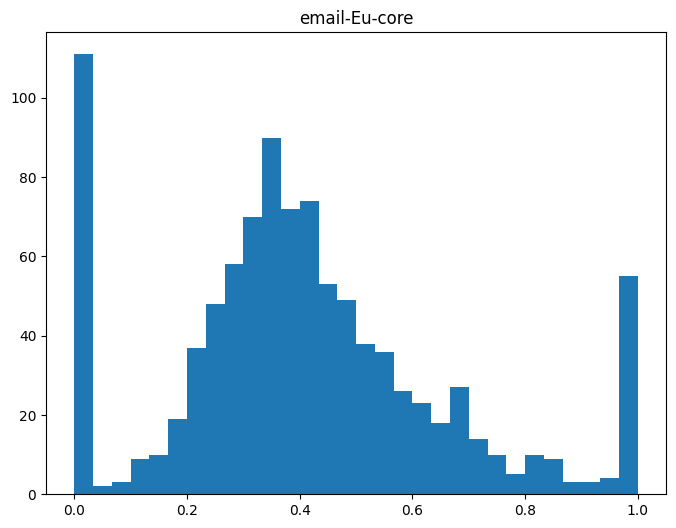

In [107]:
# find the average clustering coefficient for each topology, plot it and find the average
for i in range(len(topologies)):
    print("Average clustering coefficient of %s is %f" % (topology_names[i],nx.average_clustering(topologies[i])))
    plt.figure(figsize=(8,6))
    plt.hist(list(nx.clustering(topologies[i]).values()),bins=30)
    plt.title(topology_names[i])
    plt.show()

<h4>Μελέτη κεντρικότητας εγγύτητας για πραγματικές και συνθετικές τοπολογίες </h4>

Average closeness centrality of Football is 0.399319


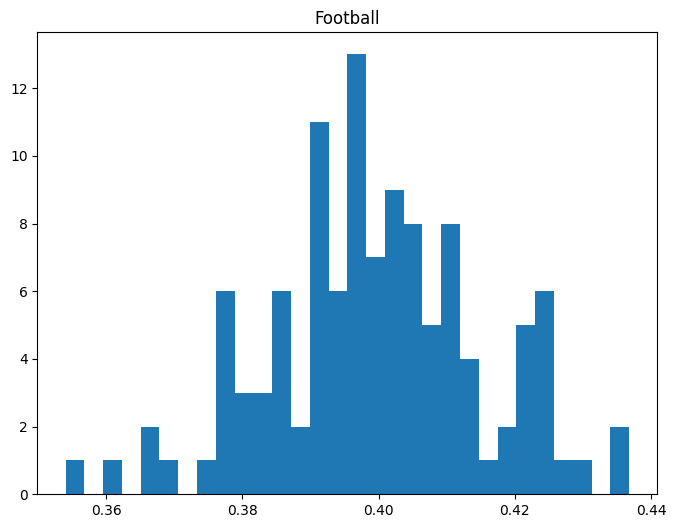

Average closeness centrality of Game of Thrones is 0.319052


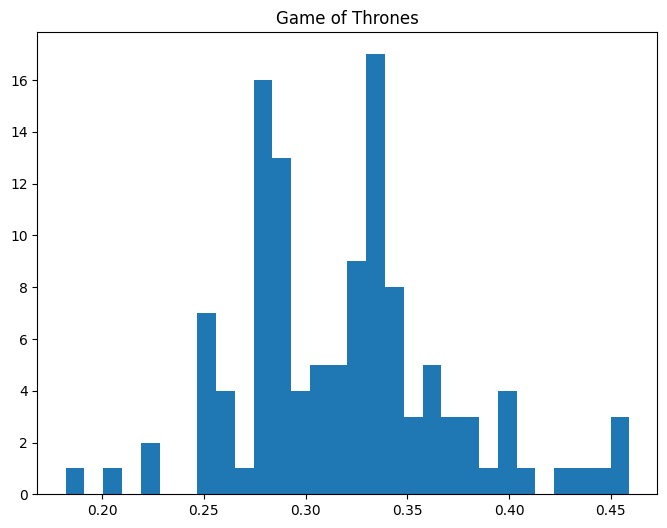

Average closeness centrality of email-Eu-core is 0.394464


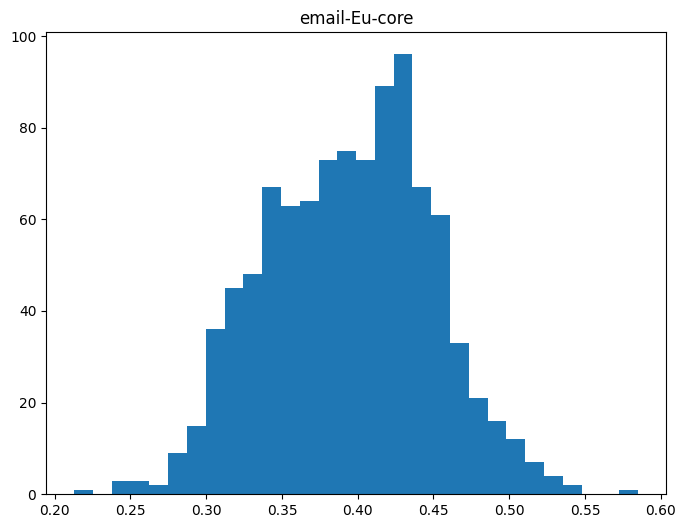

In [108]:
# find the closeness centrality for each node in each topology and plot it and find the average
for i in range(len(topologies)):
    print("Average closeness centrality of %s is %f" % (topology_names[i],np.mean(list(nx.closeness_centrality(topologies[i]).values()))))
    plt.figure(figsize=(8,6))
    plt.hist(list(nx.closeness_centrality(topologies[i]).values()),bins=30)
    plt.title(topology_names[i])
    plt.show()


### Result Analysis

- **Football:** From the above results, the distributions of closeness centrality for both the Football and Scale Free networks are quite dense and the average is very close. The same but with not that close average values happens for the clustering coefficient metric. It's remarkable to say that the distributions of closeness centrality metric for all different synthetic topologies were quite similar with the Football's. This pattern does not take place for clustering coefficient metric, where there is a big variety of distributions. For the degree metric we can say that the average between Football and Scale Free networks are quite close. Consequently, despite the fact that in some metrics the Football and Scale Free networks did not fit very well to each other, the general results are more similar than the ones of the other synthetic topologies, so we can say that the Football network is more similar to the Scale Free network.

- **Game of thrones:** The average closeness centrality of GOT network is almost the same with the Random Geometric's and as we can see from the distributions both of them follow the same representation. Another indicator that shows that the two networks are similar is the clustering coefficient because the deviation of the two is very small, approximately 0.1. As about the degree metric, from the distibutions the GOT network is more similar to the Scale Free network and less similar to the Random Geometric network, but with no significant difference. Taking into account all the above, we can say that the GOT network is more similar to the Random Geometric network.

- **Email EU-core:**  Comparing the result metrics of this network with the metrics of the synthetic networks, we can see that the Email EU-core network tends to be like the Random Gilbert network. The distributions look like normal distributions and they are very close to each other. The average of metrics in most cases are also in the same range, showing that the Email EU-core network is very similar to the Random Gilbert network.


<h3>B. Εξοικείωση με τα εργαλεία εντοπισμού κοινοτήτων</h3>
<ol>
<li>Χρησιμοποιώντας τις συναρτήσεις του <b>πίνακα 2</b> για κάθε <u>πραγματικό</u> (<b>πίνακας 1</b>) και <u>συνθετικό</u> (από την <b>άσκηση 1</b>) δίκτυο:</p>
<ol>
    <li>να οπτικοποιηθούν οι κοινότητες που προκύπτουν από την κάθε μέθοδο,</li>
    <li>να γίνουν οι απαραίτητοι σχολιασμοί (π.χ: σύγκριση του αριθμού των κοινοτήτων που υπολογίζει ο κάθε αλγόριθμος).</li>
</ol>
<p>Για την οπτικοποίηση, να επισημανθεί διαφορετικά κάθε κοινότητα, π.χ. με διαφορετικό χρώμα.</p>
<p style=text-align:justify>Στην περίπτωση των συνθετικών δικτύων, να πραγματοποιηθούν συγκρίσεις και μεταξύ των διαφορετικών τύπων τοπολογιών. Για παράδειγμα, στην περίπτωση του τυχαίου γεωμετρικού γράφου, υπάρχει διαισθητικά μία κοινότητα γύρω από κάθε κόμβο που δημιουργείται με βάση τις αποστάσεις του τελευταίου από τους υπόλοιπους κόμβους του δικτύου. Στην περίπτωση των scale-free δικτύων, είναι πιθανό να σχηματίζονται κοινότητες γύρω από τους κόμβους με μεγάλο βαθμό.</p>
<li>Για κάθε αλγόριθμο εντοπισμού κοινοτήτων και για κάθε τοπολογία αξιολογήστε την ποιότητα της διαμέρισης με τις μετρικές performance και modularity (<a style=text-decoration:none href='https://networkx.org/documentation/stable/reference/algorithms/community.html#module-networkx.algorithms.community.quality'>measuring_partitions</a>). Για την μετρική performance, θα χρησιμοποιήσετε την συνάρτηση partition_quality του networkx.</li>
<li>Για την μεγαλύτερη συνδεδεμένη συνιστώσα του email-Eu-core, να συγκρίνετε την ground-truth διαμέριση που δίνεται στο αρχείο Email-Eu-core-department-labels.txt με τις διαμερίσεις που προκύπτουν από τις εξεταζόμενες μεθόδους ως προς το πλήθος των παραγόμενων κοινοτήτων και ως προς τις μετρικές performance και modularity. </li>
<li>Για την παρακολούθηση του χρόνου εκτέλεσης της υλοποίησής σας, μπορείτε να χρησιμοποιήσετε τις βιωλιοθήκες <a style=text-decoration:none href='https://tqdm.github.io/'>tqdm</a> και <a style=text-decoration:none href='https://docs.python.org/3/library/time.html'>time</a> . Στο σχολιασμό σας να λάβετε υπόψη το trade-off της ποιότητας της διαμέρισης και του χρόνου εκτέλεσης των εξεταζόμενων αλγορίθμων. </li>
</ol>

<table style=float:left;width:70%>
    <caption>Πίνακας <b>2</b>: Συναρτήσεις εντοπισμού κοινοτήτων</caption>
    <tr>
        <th style=text-align:left> Μέθοδος εντοπισμού κοινοτήτων</th>
        <th style=text-align:left>Συνάρτηση</th>
    </tr>
    <tr>
        <td style=text-align:left>Spectral Clustering</td>
        <td style=text-align:left><a style=text-decoration:none href='http://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html'>SpectralClustering</a></td>
    </tr>
       <tr>
        <td style=text-align:left>Newman-Girvan</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html'>girvan_newman</a></td>
    </tr>
    <tr>
        <td style=text-align:left>Modularity Maximization</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html'>greedy_modularity_communities</a></td>
    </tr>
</table>
    

<p style=text-align:justify>Προτού εφαρμόσετε τις συναρτήσεις εντοπισμού κοινοτήτων μελετήστε προσεκτικά την <b>είσοδο που απαιτούν καθώς και τη μορφή εξόδου που παράγουν.</b></p>

In [109]:
#Χρησιμοποιήστε την συνάρτηση conv2int για να μετατρέψετε τα labels των κόμβων στις πραγματικ΄ές τοπολογίες σε integers
def conv2int(G,start_value):
    nG = nx.convert_node_labels_to_integers(G,first_label=start_value)
    G_mapping=dict(enumerate(G.nodes,0))
    return nG,G_mapping

<h4> Ορισμός χρωμάτων για την οπτικοποίηση των κοινοτήτων.</h4>

In [110]:
#insert colors for nodes
from matplotlib import colors as mcolors
colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())


<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Newman-Girvan.</h4>
<p>Παράξτε τις διαμερίσεις που προκύπτουν από την μέθοδο Newman-Girvan. Ελέγξτε τις διαμερίσεις που έχουν μέχρι και 50 κοινότητες.</p> 
<p> Επιλέξτε τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

In [111]:
# This cell contains general functions for the algorithms

football,G_mapping = conv2int(football,0)
got,G_mapping = conv2int(got,0)
eu,G_mapping = conv2int(eu,0)

topologies = [REG,RGER,RGG,SF,SW,football,got,eu]
topology_names = ["REG","RGER","RGG","SF","SW","football","got","eu"]

football_communities = []
got_communities = []
eu_communities = []
REG_communities = []
RGER_communities = []
RGG_communities = []
SF_communities = []
SW_communities = []

# map each list with the stirng name of the topology
topology_mapping = {"REG":REG_communities,"RGER":RGER_communities,"got":got_communities,"eu":eu_communities,"RGG":RGG_communities,"SF":SF_communities,"SW":SW_communities,"football":football_communities}


In [112]:

# The algorithm removes the “most valuable” edge,
# traditionally the edge with the highest betweenness centrality, at each step
from networkx.algorithms.community.centrality import girvan_newman
import itertools
import pandas as pd
import time
# initialize the dataframes with the columns
df = pd.DataFrame(columns=['#Communities max Modularity', '#Communities max Performance','max_modularity','max_performance','Time'])

# number of communities
k = 50

# find the communities using the girvan_newman algorithm with the biggest modularity score and performance score for each topology
for i in range(len(topologies)): 
    
    start = time.time()
    communities_generator = girvan_newman(topologies[i])  

    # limited is the partitions with maximum k communities
    limited = list(itertools.takewhile(lambda c: len(c) <= k, communities_generator))
    #return the partition from communities with the biggest modularity score
    max_partition_modularity = max(limited, key=lambda c: nx.algorithms.community.modularity(topologies[i], c))
    # max modularity score
    max_modularity = nx.algorithms.community.modularity(topologies[i], max_partition_modularity)
    # return the partition from communities with the biggest performance score
    max_partition_performance = max(limited, key=lambda c: nx.algorithms.community.partition_quality(topologies[i], c))
    # max performance score
    max_performance = nx.algorithms.community.partition_quality(topologies[i], max_partition_performance)[1]

    end = time.time()

    df.loc[topology_names[i]] = [len(max_partition_modularity), len(max_partition_performance),max_modularity,max_performance,end-start]

    # add in topologies_metrics the modularity score and performance score for each topology
    topology_mapping[topology_names[i]].append(("girvan_newman:max_partition_modularity", max_partition_modularity))
    topology_mapping[topology_names[i]].append(("girvan_newman:max_partition_performance", max_partition_performance))



from IPython.display import Markdown as md

# display the results of the classifiers in a markdown table
markDownTableResults = df.to_markdown()
md(markDownTableResults)
    
 


|          |   #Communities max Modularity |   #Communities max Performance |   max_modularity |   max_performance |       Time |
|:---------|------------------------------:|-------------------------------:|-----------------:|------------------:|-----------:|
| REG      |                             8 |                              2 |      0.725       |          0.553165 |   0.186239 |
| RGER     |                            24 |                              2 |      0.211094    |          0.118671 |   1.17436  |
| RGG      |                             5 |                              2 |      0.597049    |          0.621835 |   0.911894 |
| SF       |                            30 |                              2 |      0.136383    |          0.12057  |   1.15088  |
| SW       |                             8 |                              2 |      0.574102    |          0.39557  |   0.281115 |
| football |                            10 |                              2 |      0.599629    |          0.579252 |   2.90867  |
| got      |                             8 |                              2 |      0.668121    |          0.472297 |   0.999096 |
| eu       |                             2 |                              2 |      0.000621882 |          0.045156 | 222.053    |

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Spectral Clustering. </h4>
Προσοχή! Για την επιλογή της τιμής της παραμέτρου που αφορά στην διάσταση του projection subspace (n_clusters) της συνάρτησης SpectralClustering, θα πρέπει να λάβετε υπόψη το μέγεθος |V| του εκάστοτε δικτύου.
<p>Να εξετάσετε τις διαμερίσεις που προκύπτουν για n_clusters$=2,...,|V|$. Να επιλέξετε για οπτικοποίηση τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

In [113]:
# import SpectralClustering from sklearn
from sklearn.cluster import SpectralClustering
import pandas as pd
import time
# initialize the dataframes with the columns
df = pd.DataFrame(columns=['#Communities max Modularity', '#Communities max Performance','max_modularity','max_performance','Time'])

# find the communities using the spectral clustering algorithm with the biggest modularity score and performance score for each topology
for i in range(len(topologies)):
    # define communities as an array with tuples
    communities = []
    # start time
    start = time.time()
    for k in range(2,50):
        # create the spectral clustering model
        spectral = SpectralClustering(n_clusters=k,affinity='precomputed').fit(np.array(nx.adjacency_matrix(topologies[i]).todense()))
        # find the communities
        communities_dict = dict(zip(topologies[i].nodes, spectral.labels_))
        # create a list of sets of the communities
        communities_list = [set([n for n in communities_dict if communities_dict[n] == i]) for i in range(k)]
        # transform the communities list to a tuple
        communities_tuple = tuple(communities_list)
        # append the tuple to the communities array
        communities.append(communities_tuple)
        
        
    #return the partition from communities with the biggest modularity score
    max_partition_modularity = max(communities, key=lambda c: nx.algorithms.community.modularity(topologies[i], c))
    # max modularity score
    max_modularity = nx.algorithms.community.modularity(topologies[i], max_partition_modularity)
    # return the partition from communities with the biggest performance score
    max_partition_performance = max(communities, key=lambda c: nx.algorithms.community.partition_quality(topologies[i], c))
    # max performance score from max_partition_performance tuple
    max_performance = nx.algorithms.community.partition_quality(topologies[i], max_partition_performance)[1]
    # end time
    end = time.time()

    df.loc[topology_names[i]] = [len(max_partition_modularity), len(max_partition_performance),max_modularity,max_performance,end-start]

    # add in topologies_metrics the modularity score and performance score for each topology
    topology_mapping[topology_names[i]].append(("SpectralClustering:max_partition_modularity", max_partition_modularity))
    topology_mapping[topology_names[i]].append(("SpectralClustering:max_partition_performance", max_partition_performance))


from IPython.display import Markdown as md

# display the results of the classifiers in a markdown table
markDownTableResults = df.to_markdown()
md(markDownTableResults)
    
   

|          |   #Communities max Modularity |   #Communities max Performance |   max_modularity |   max_performance |      Time |
|:---------|------------------------------:|-------------------------------:|-----------------:|------------------:|----------:|
| REG      |                             8 |                              2 |         0.725    |          0.552848 |  0.879709 |
| RGER     |                            10 |                              2 |         0.283644 |          0.536392 |  0.94999  |
| RGG      |                             6 |                              2 |         0.602183 |          0.621835 |  0.86116  |
| SF       |                             4 |                              2 |         0.268022 |          0.532595 |  0.862803 |
| SW       |                             7 |                              2 |         0.560703 |          0.544304 |  0.852391 |
| football |                            11 |                              2 |         0.602201 |          0.567658 |  3.68793  |
| got      |                             7 |                              2 |         0.665417 |          0.472297 |  3.7927   |
| eu       |                            11 |                              2 |         0.383077 |          0.186534 | 36.1817   |

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Modularity Maximization.</h4>
Για την διαμέριση που θα προκύψει σε κάθε συνθετικό και πραγματικό δίκτυο, να υπολογίσετε το modularity score και το performance score.

In [114]:
from networkx.algorithms.community import greedy_modularity_communities
import pandas as pd
import time
# initialize the dataframes with the columns
df = pd.DataFrame(columns=['Modularity Score', 'Performance Score','Time'])

for i in range(len(topologies)):
    # start time
    start = time.time()
    # find the communities
    communities = greedy_modularity_communities(topologies[i])
    # convert frozesent to set
    communities = [set(c) for c in communities]
    # compute the modularity score
    modularity = nx.algorithms.community.modularity(topologies[i], communities)
    # compute the performance score
    performance = nx.algorithms.community.performance(topologies[i], communities)
    # end time
    end = time.time()
    # append the modularity and performance scores to the dataframe and name the rows with the topology names
    df.loc[topology_names[i]] = [modularity, performance,end-start]
    # add in topologies_metrics the modularity score and performance score for each topology
    topology_mapping[topology_names[i]].append(("greedy_modularity_communities", tuple(communities)))

        


from IPython.display import Markdown as md

# display the results of the classifiers in a markdown table
markDownTableResults = df.to_markdown()
md(markDownTableResults)



|          |   Modularity Score |   Performance Score |      Time |
|:---------|-------------------:|--------------------:|----------:|
| REG      |           0.673125 |            0.800633 | 0.0139871 |
| RGER     |           0.28365  |            0.759177 | 0.0191288 |
| RGG      |           0.585373 |            0.829114 | 0.0182562 |
| SF       |           0.270002 |            0.793987 | 0.0195768 |
| SW       |           0.563203 |            0.900316 | 0.014348  |
| football |           0.549741 |            0.868192 | 0.0382452 |
| got      |           0.660478 |            0.829796 | 0.0324008 |
| eu       |           0.347133 |            0.707872 | 2.92045   |

In [115]:
# functions I am gonna use to draw the graphs

def set_node_community(G, communities):
        '''Add community to node attributes'''
        for c, v_c in enumerate(communities):
            for v in v_c:
                # Add 1 to save 0 for external edges
                G.nodes[v]['community'] = c + 1
def set_edge_community(G):
    '''Find internal edges and add their community to their attributes'''
    for v, w, in G.edges:
        if G.nodes[v]['community'] == G.nodes[w]['community']:
            # Internal edge, mark with community
            G.edges[v, w]['community'] = G.nodes[v]['community']
        else:
            # External edge, mark as 0
            G.edges[v, w]['community'] = 0
def get_color(i, r_off=1, g_off=1, b_off=1):
    '''Assign a color to a vertex.'''
    r0, g0, b0 = 0, 0, 0
    n = 16
    low, high = 0.1, 0.9
    span = high - low
    r = low + span * (((i + r_off) * 3) % n) / (n - 1)
    g = low + span * (((i + g_off) * 5) % n) / (n - 1)
    b = low + span * (((i + b_off) * 7) % n) / (n - 1)
    return (r, g, b)

#### Οπτικοποίηση κοινοτήτων American College Football

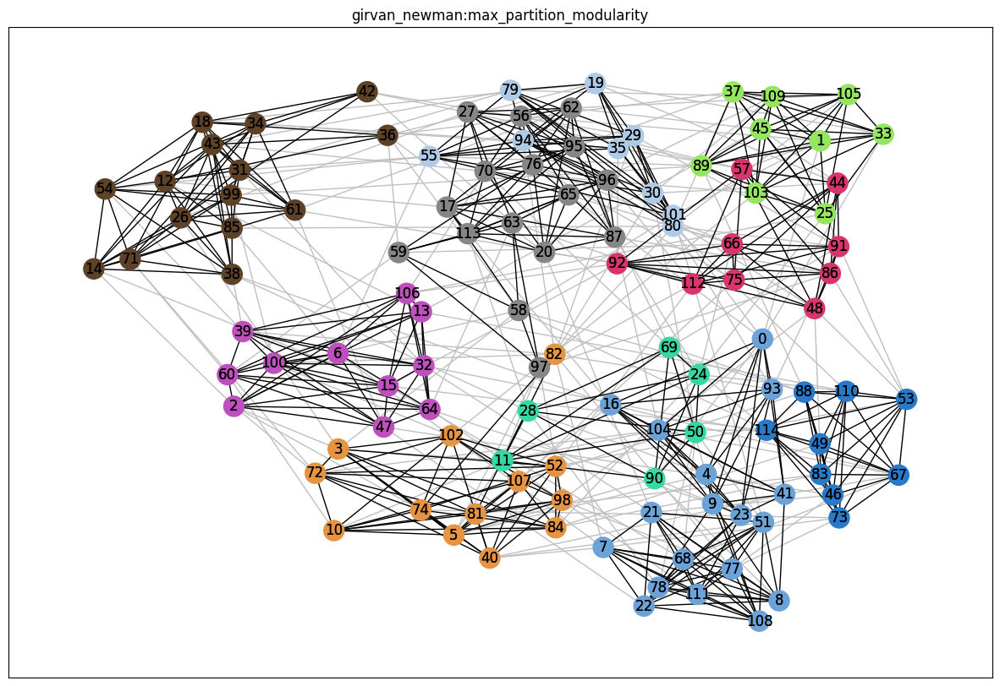

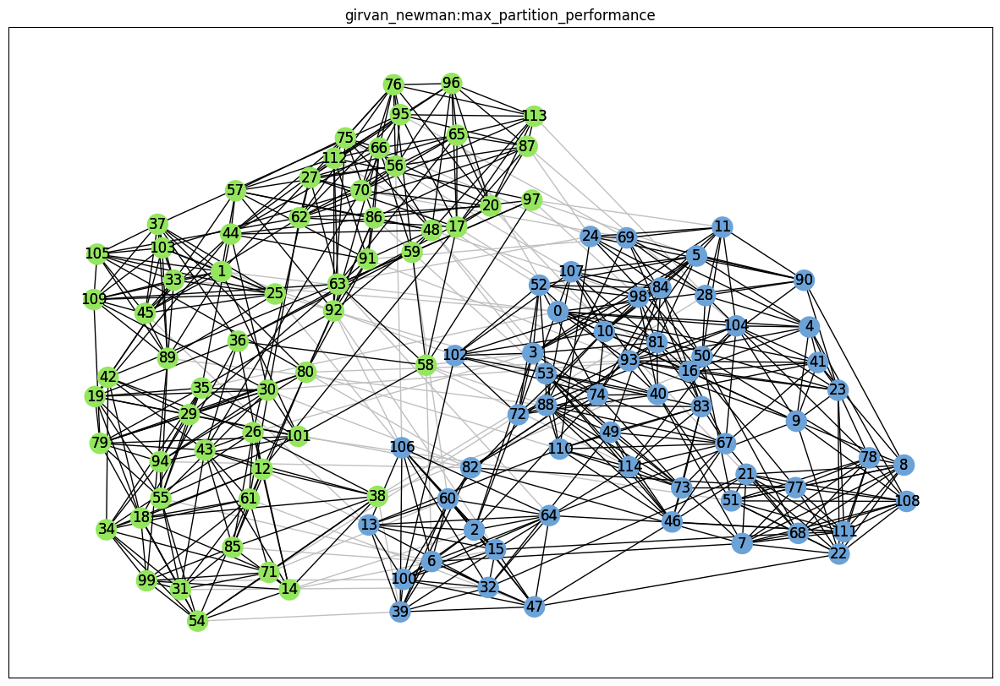

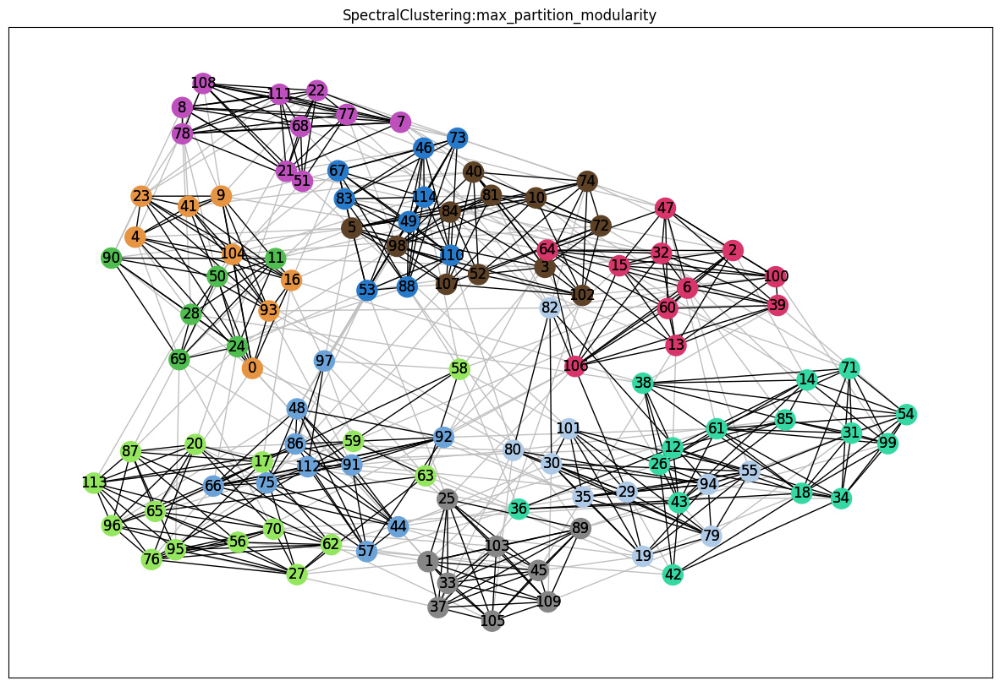

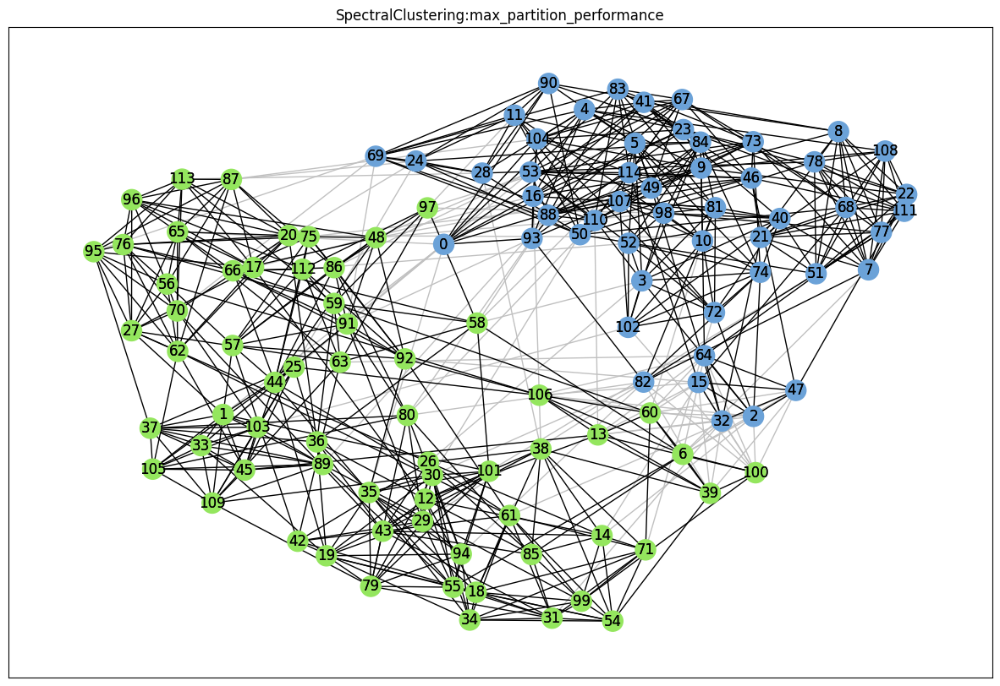

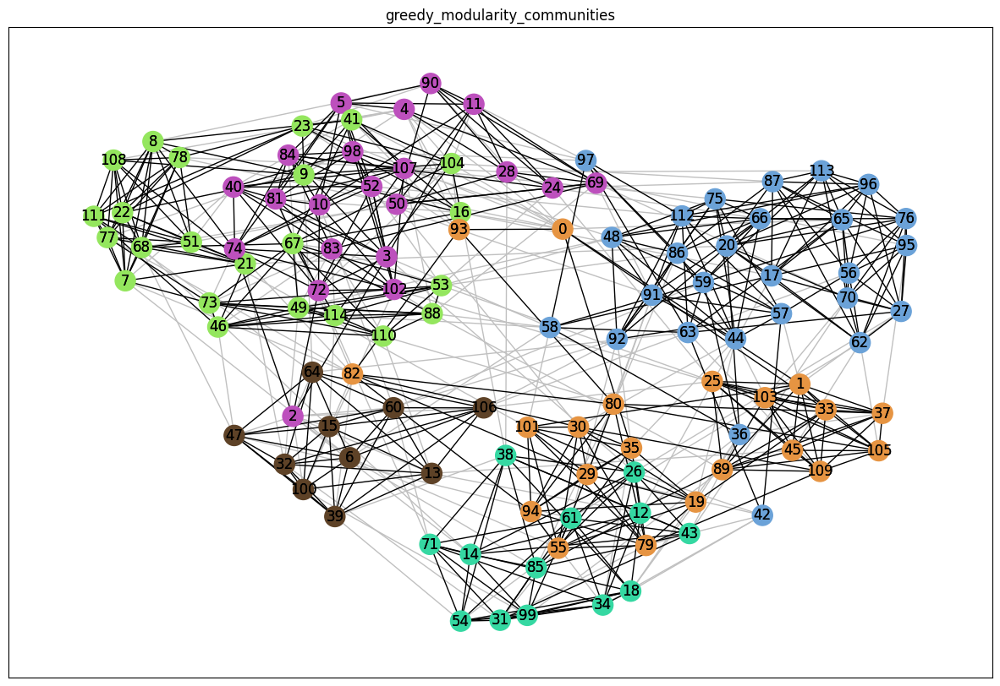

In [116]:

for i in range(len(football_communities)):
    # Set node and edge communities
    set_node_community(football, football_communities[i][1])
    set_edge_community(football)
    node_color = [get_color(football.nodes[v]['community']) for v in football.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in football.edges if football.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in football.edges if football.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    football_pos = nx.spring_layout(football)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        football,
        pos=football_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        football,
        pos=football_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(football_communities[i][0])  

    # show each graph separately
    plt.show()
    
    



#### Οπτικοποίηση κοινοτήτων Game of Thrones

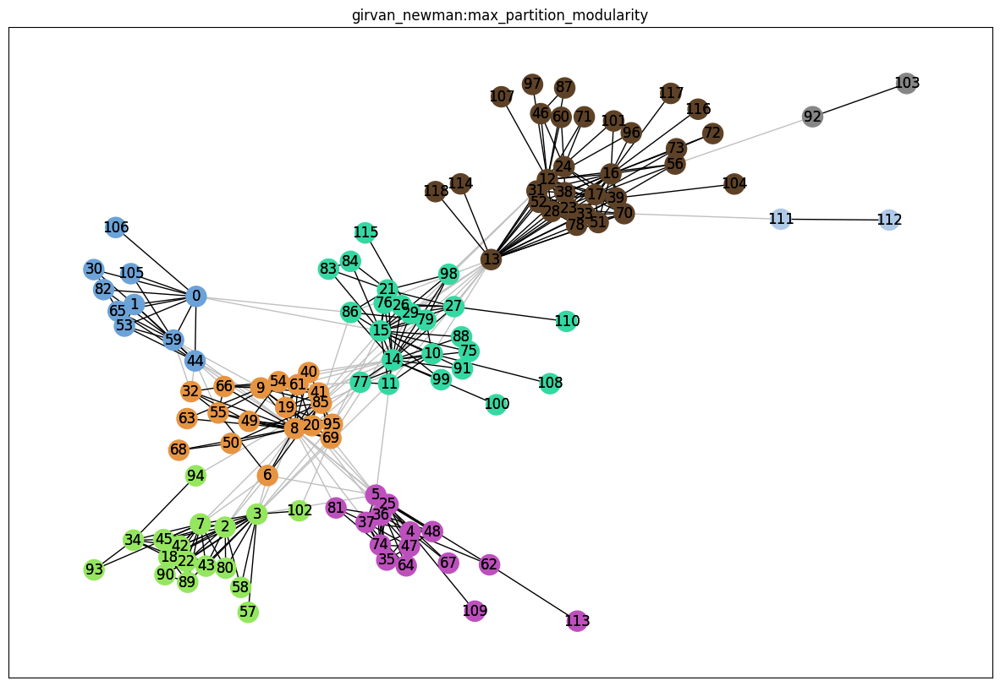

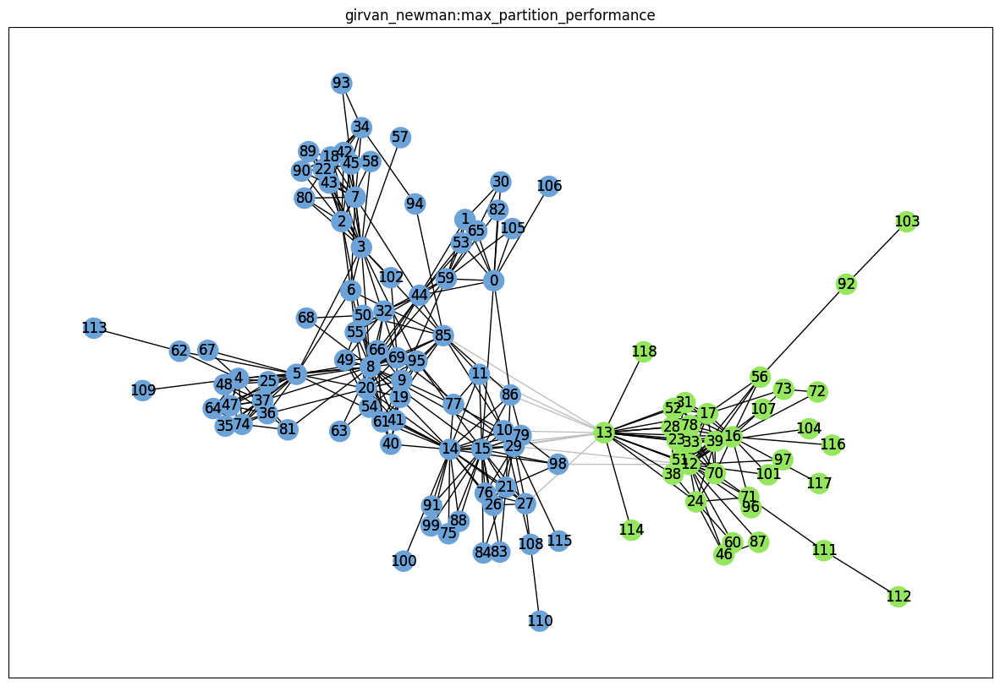

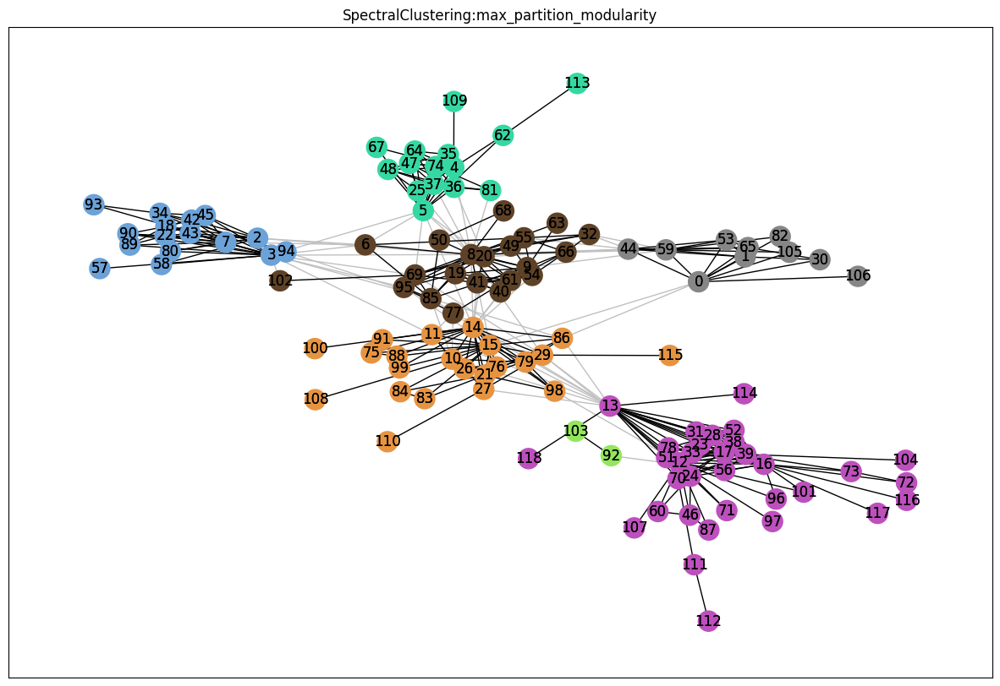

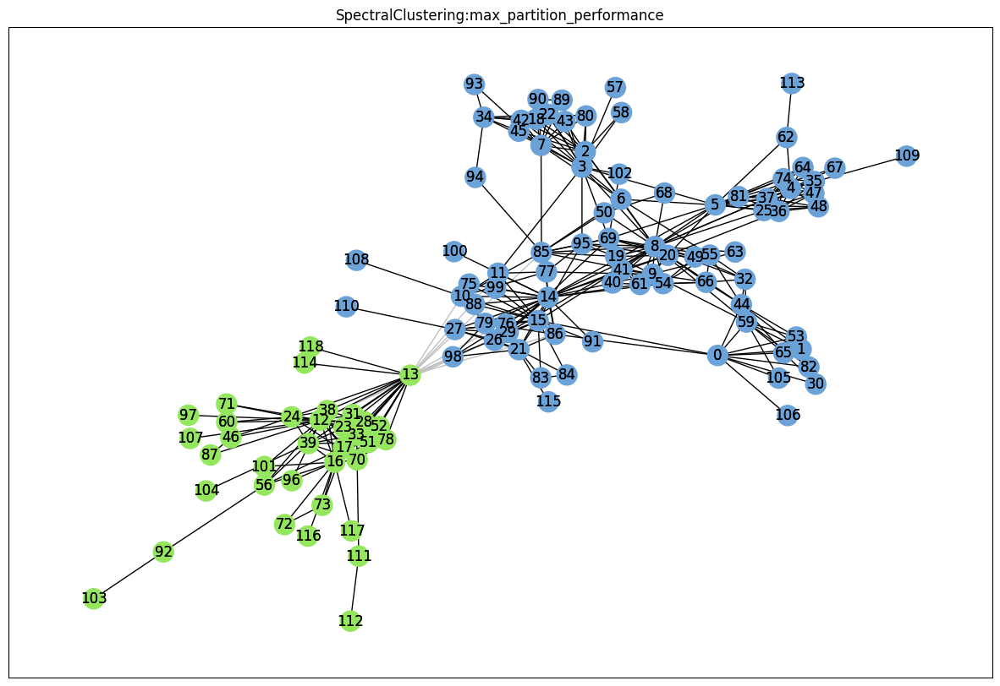

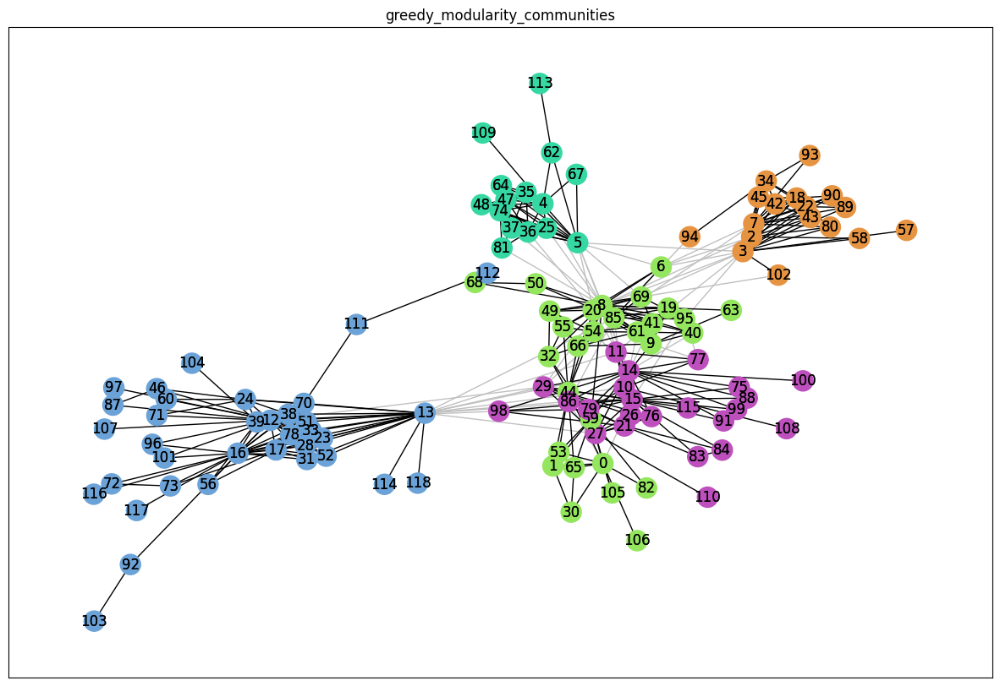

In [117]:
# do the same for got_communities
for i in range(len(got_communities)):
    # Set node and edge communities
    set_node_community(got, got_communities[i][1])
    set_edge_community(got)
    node_color = [get_color(got.nodes[v]['community']) for v in got.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in got.edges if got.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in got.edges if got.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    got_pos = nx.spring_layout(got)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        got,
        pos=got_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        got,
        pos=got_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(got_communities[i][0])  

    # show each graph separately
    plt.show()

#### Οπτικοποίηση κοινοτήτων email-Eu-core (να οπτικοποιηθεί και η ground-truth διαμέριση)

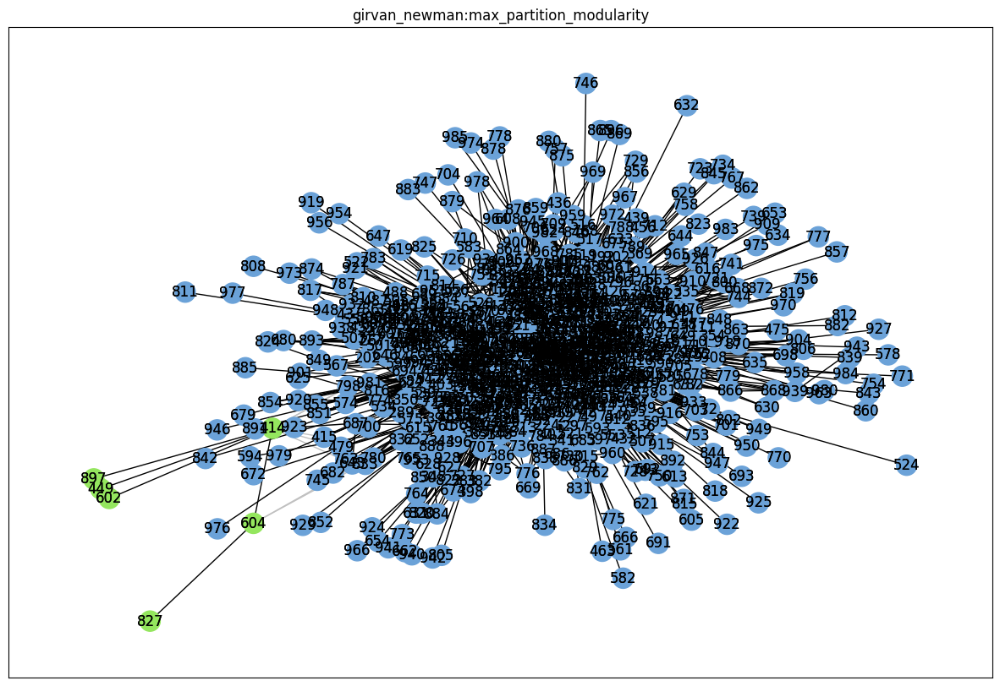

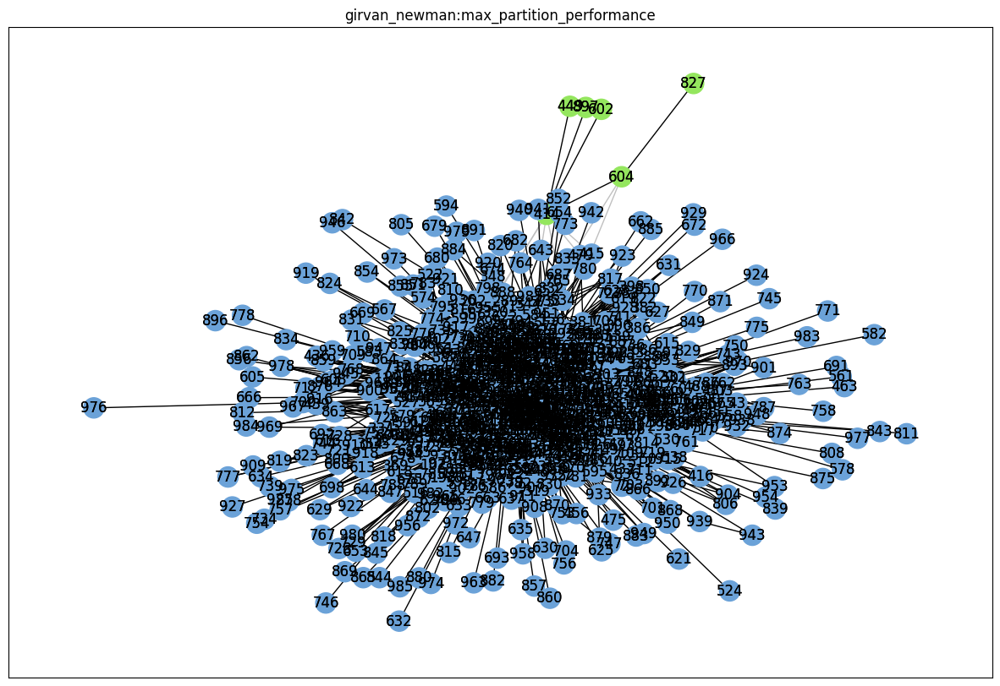

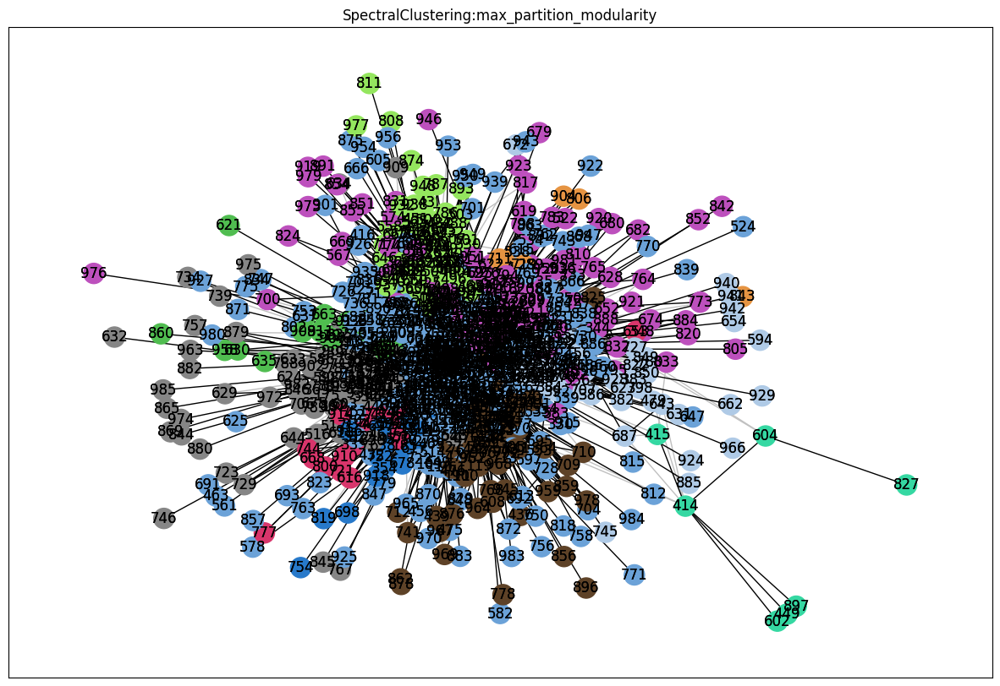

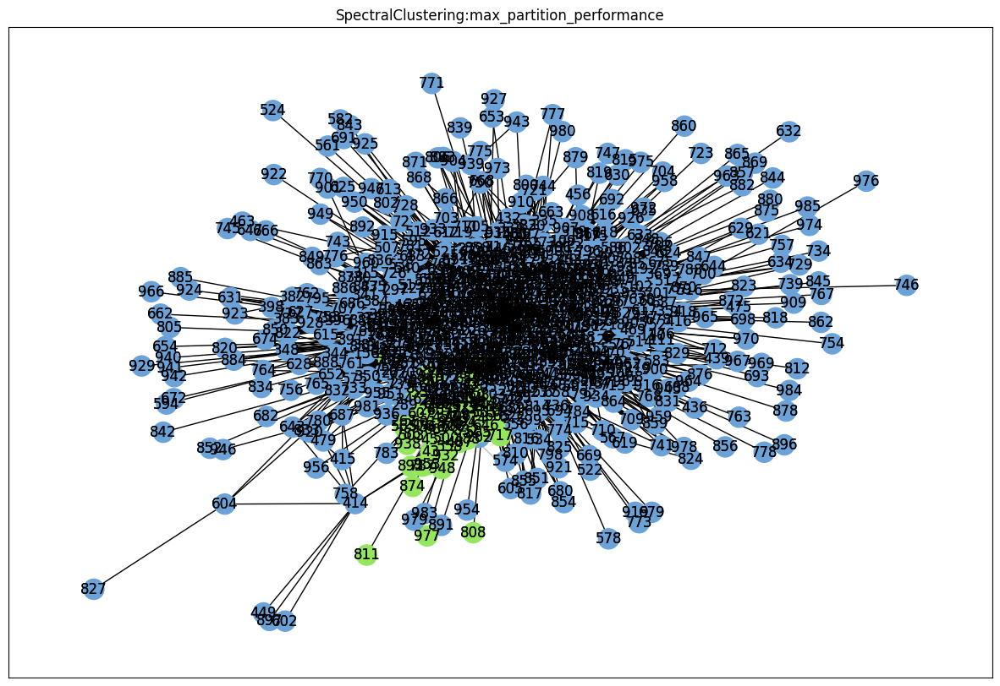

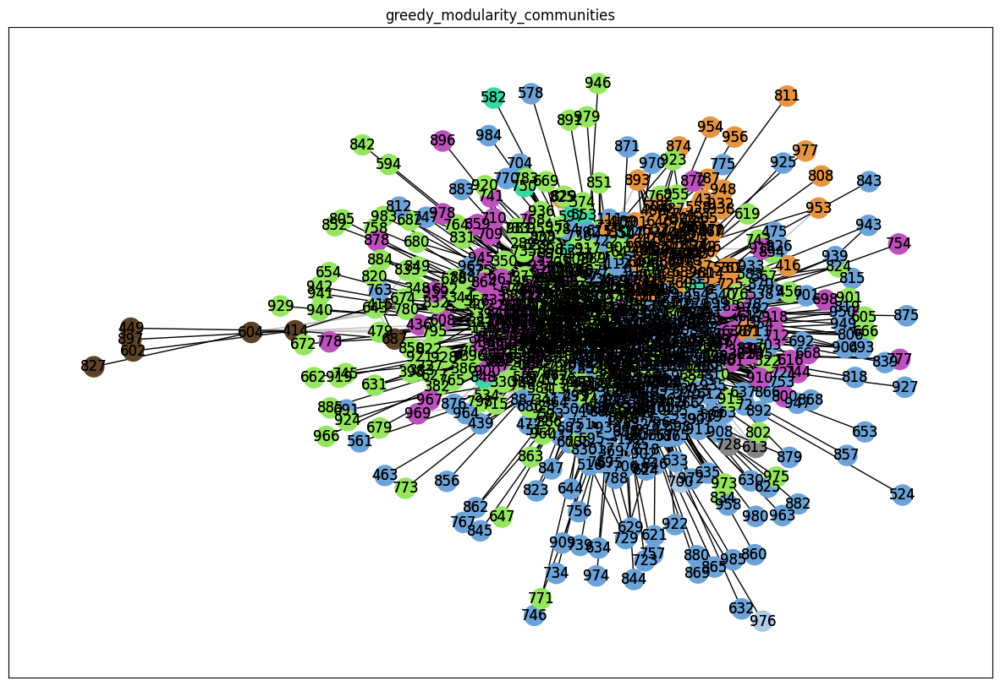

In [118]:
for i in range(len(eu_communities)):
    # Set node and edge communities
    set_node_community(eu, eu_communities[i][1])
    set_edge_community(eu)
    node_color = [get_color(eu.nodes[v]['community']) for v in eu.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in eu.edges if eu.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in eu.edges if eu.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    eu_pos = nx.spring_layout(eu)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        eu,
        pos=eu_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        eu,
        pos=eu_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(eu_communities[i][0])  

    # show each graph separately
    plt.show()

#### Οπτικοποίηση κοινοτήτων REG

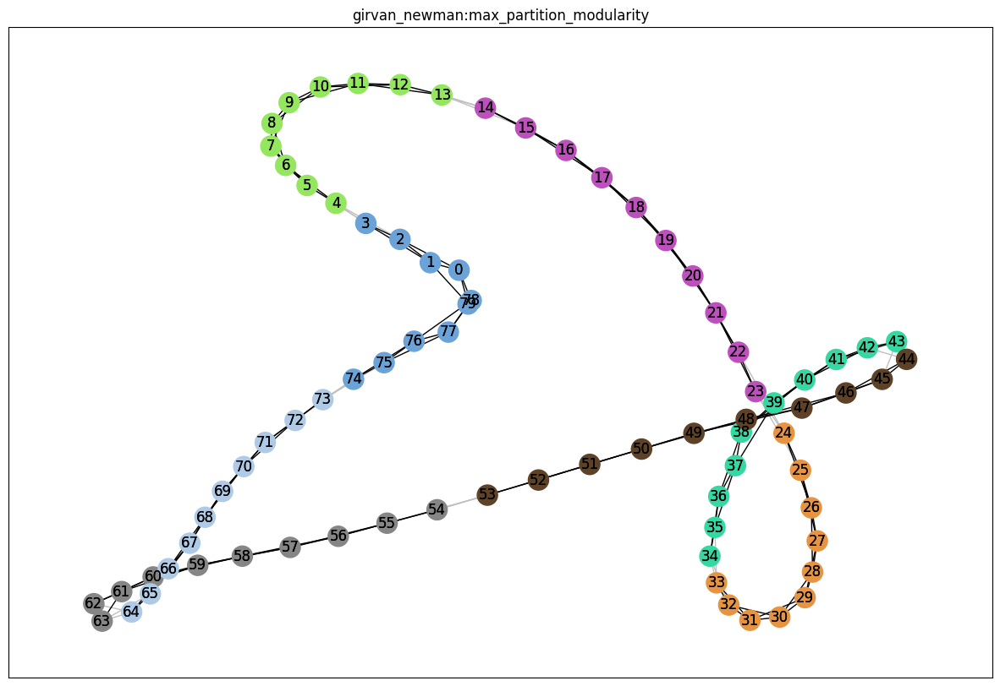

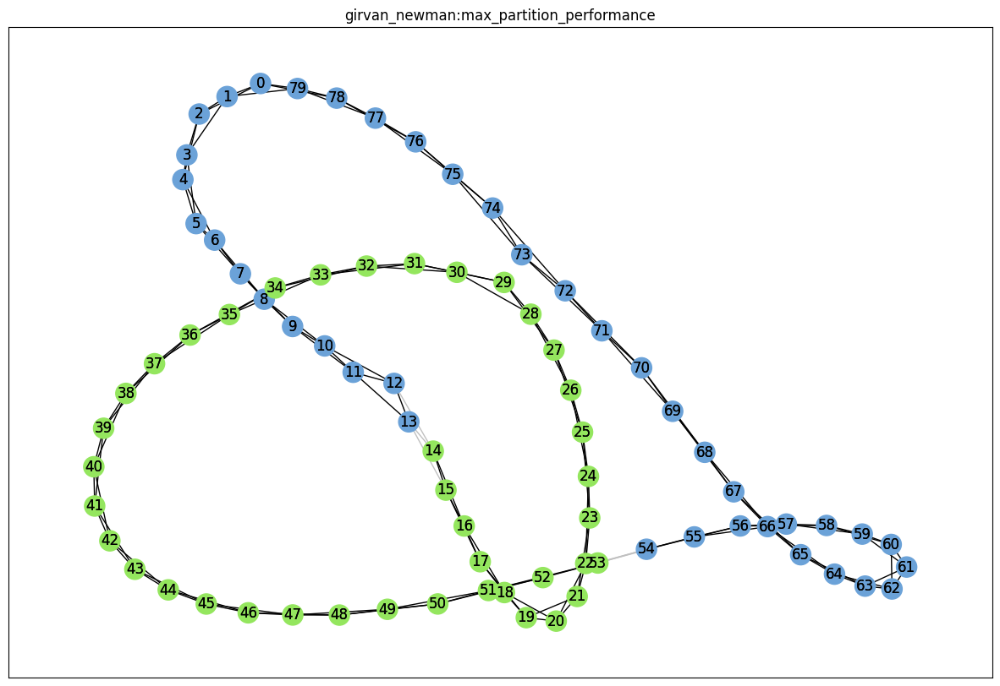

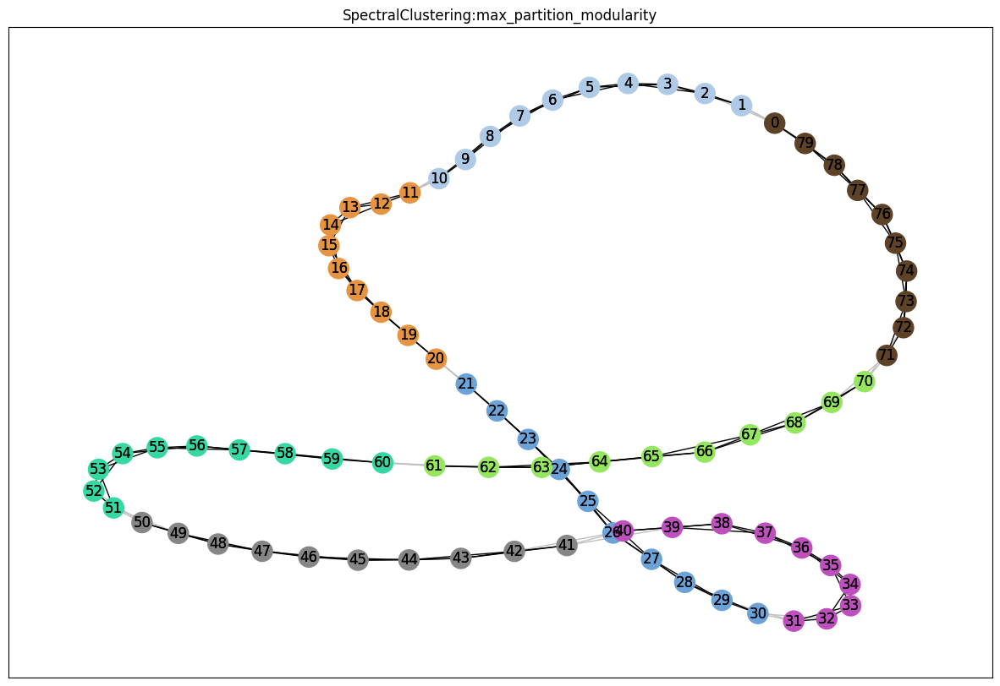

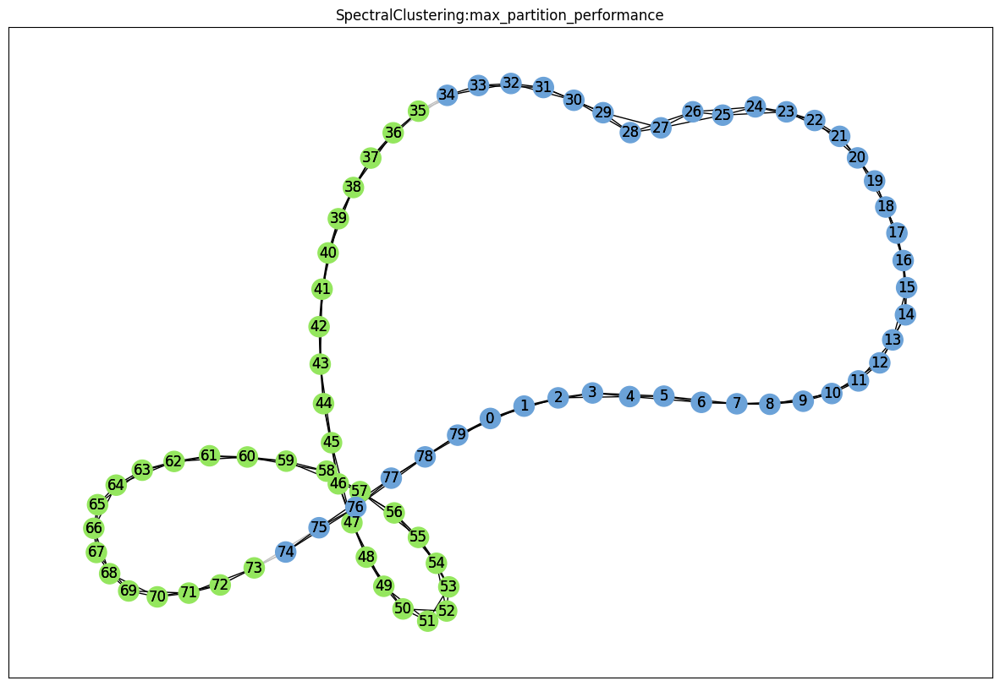

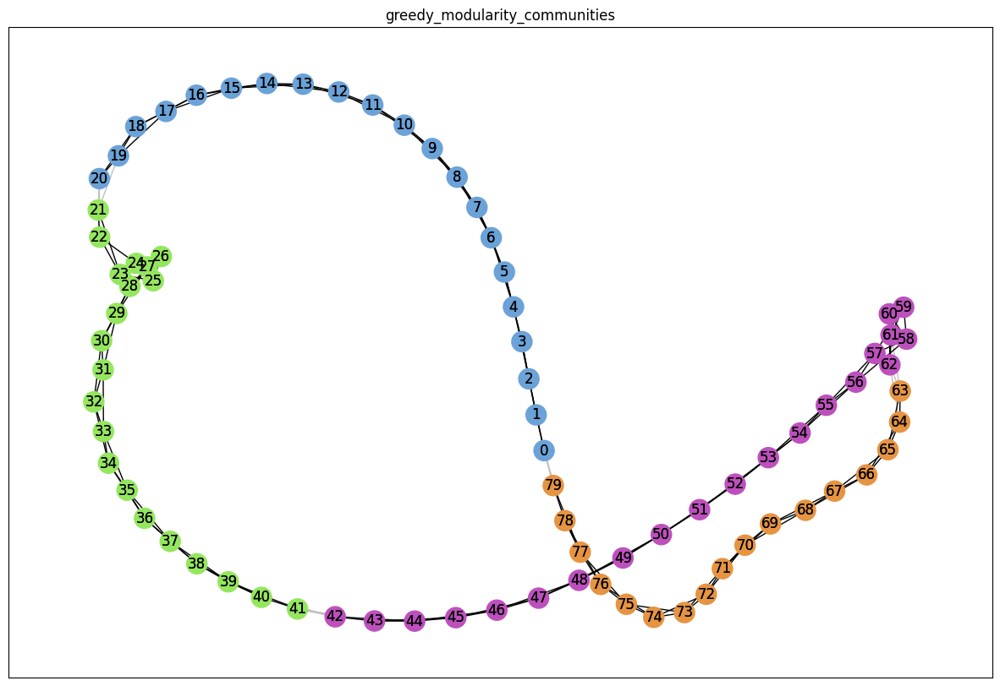

In [119]:
for i in range(len(REG_communities)):
    # Set node and edge communities
    set_node_community(REG, REG_communities[i][1])
    set_edge_community(REG)
    node_color = [get_color(REG.nodes[v]['community']) for v in REG.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in REG.edges if REG.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in REG.edges if REG.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    REG_pos = nx.spring_layout(REG)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        REG,
        pos=REG_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        REG,
        pos=REG_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(REG_communities[i][0])  

    # show each graph separately
    plt.show()

#### Οπτικοποίηση κοινοτήτων RGER

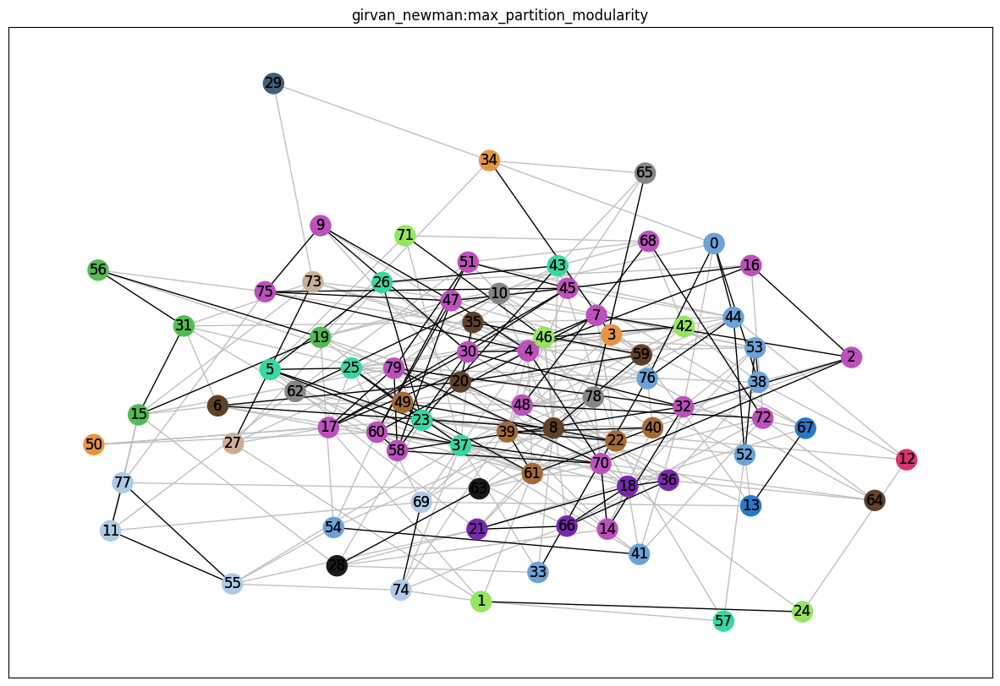

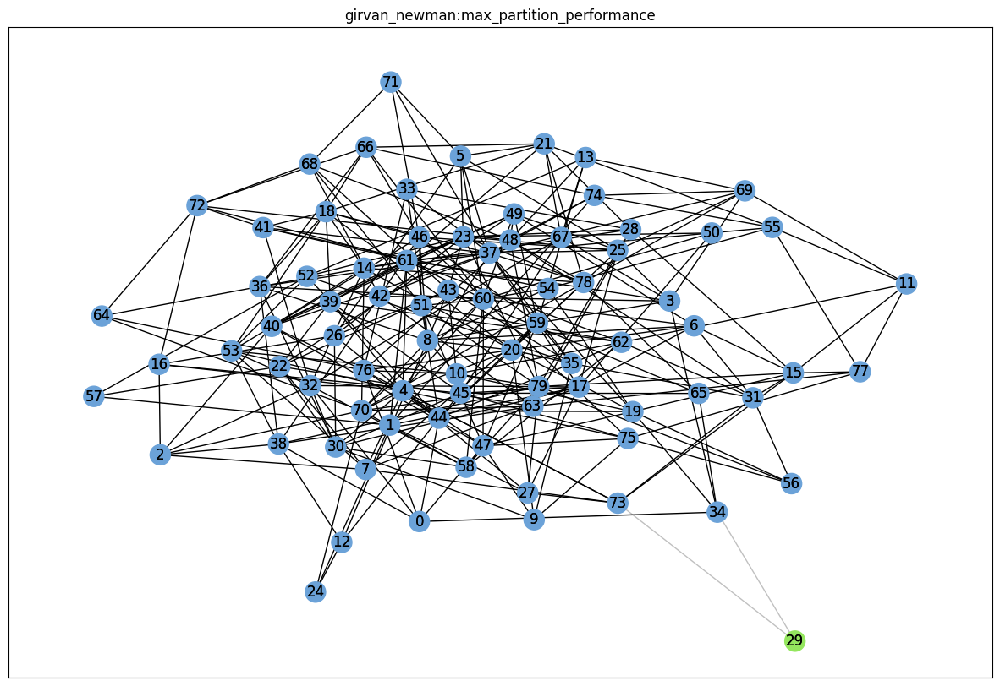

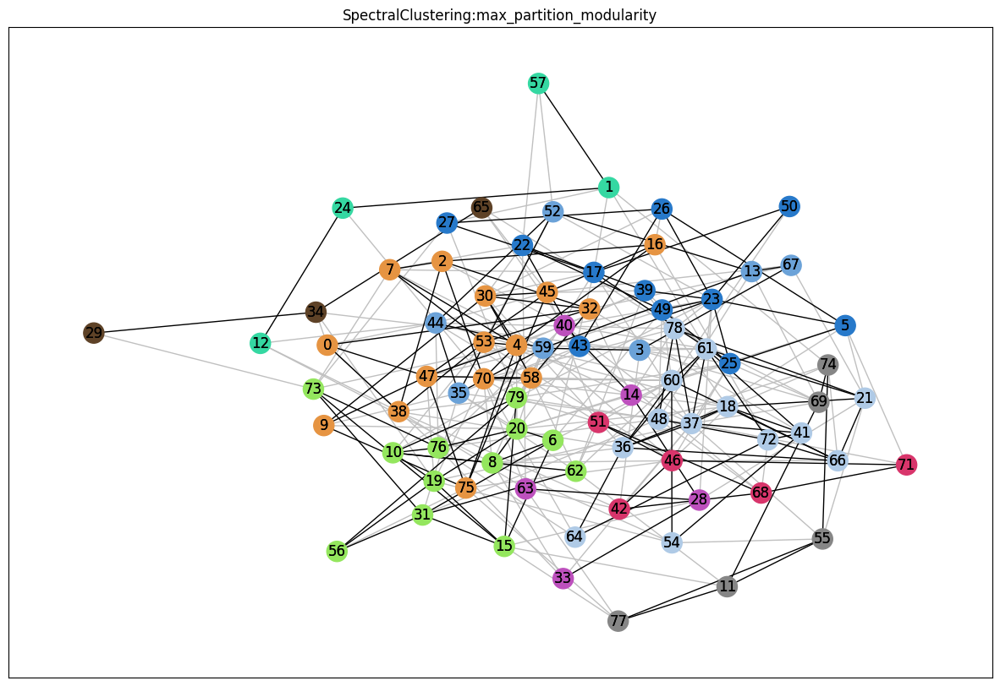

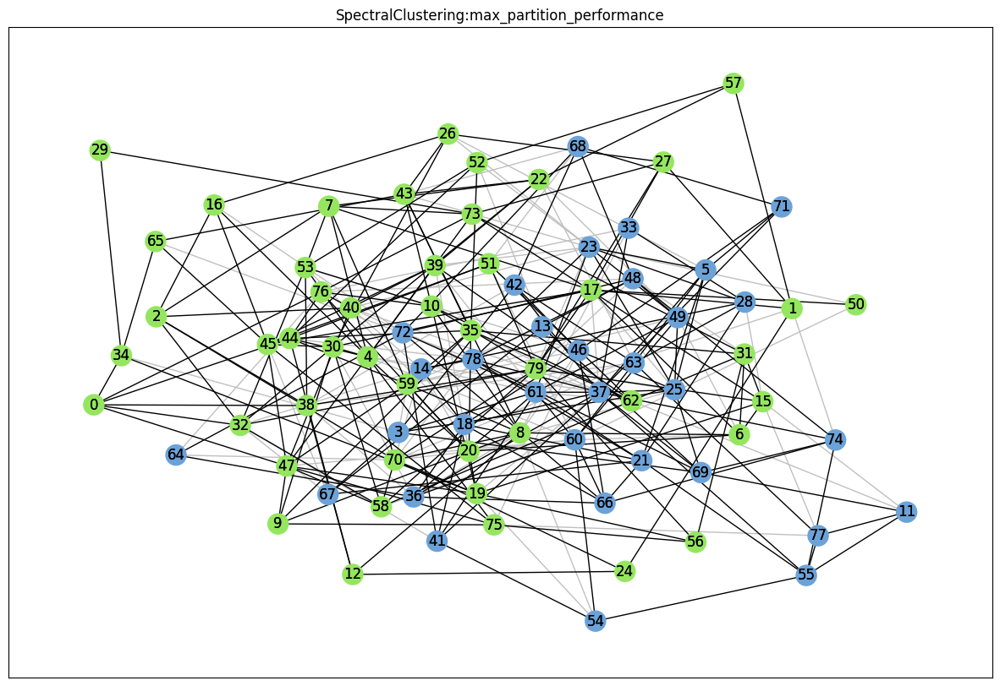

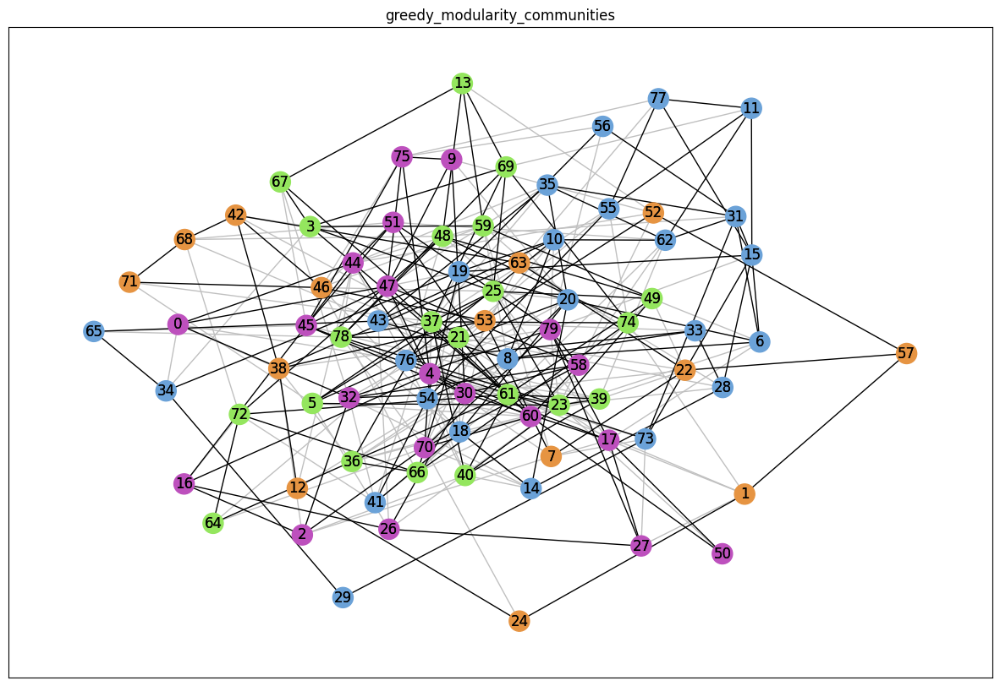

In [120]:
for i in range(len(RGER_communities)):
    # Set node and edge communities
    set_node_community(RGER, RGER_communities[i][1])
    set_edge_community(RGER)
    node_color = [get_color(RGER.nodes[v]['community']) for v in RGER.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in RGER.edges if RGER.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in RGER.edges if RGER.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    RGER_pos = nx.spring_layout(RGER)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        RGER,
        pos=RGER_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        RGER,
        pos=RGER_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(RGER_communities[i][0])  

    # show each graph separately
    plt.show()

#### Οπτικοποίηση κοινοτήτων RGG

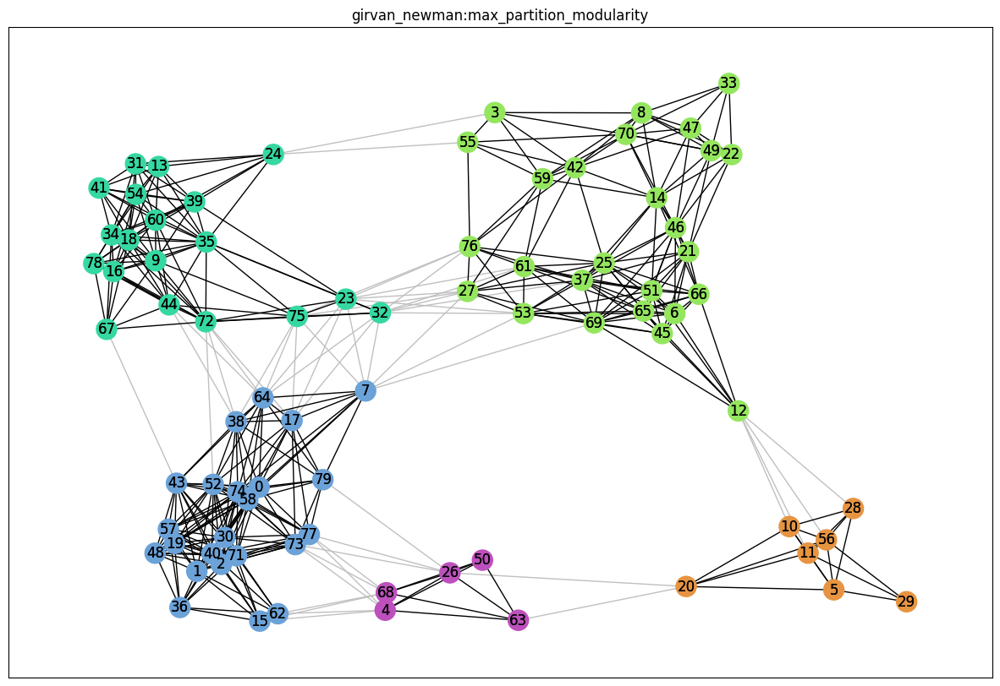

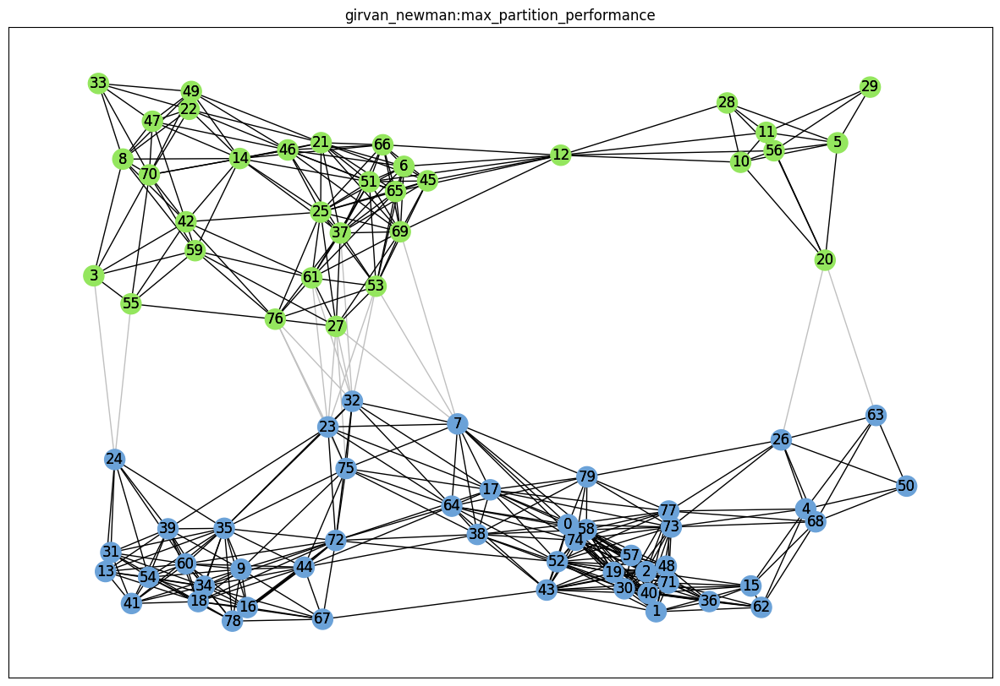

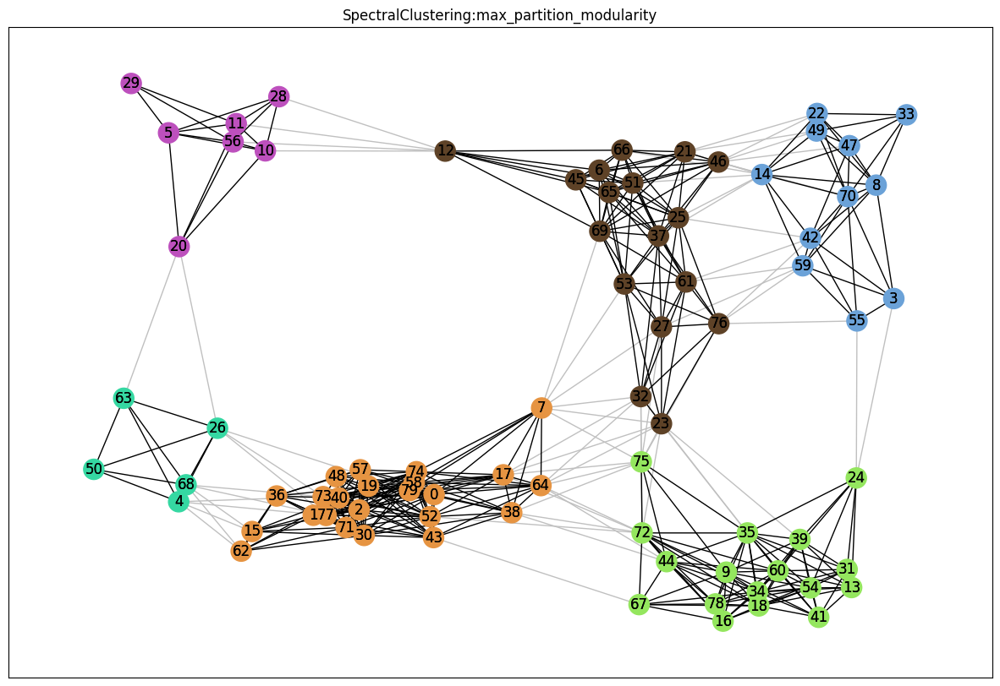

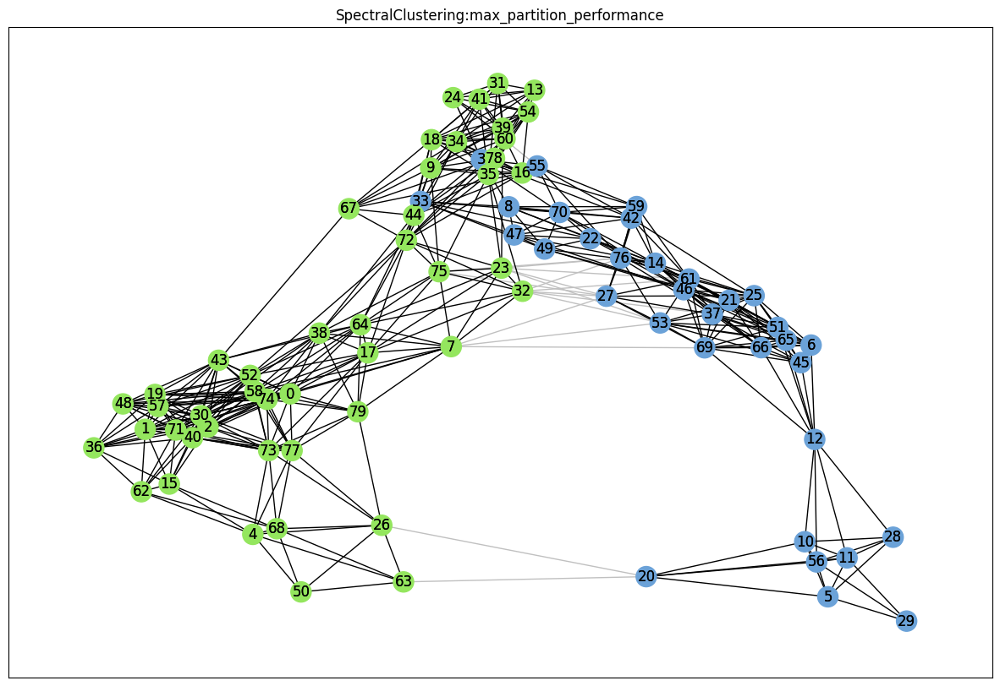

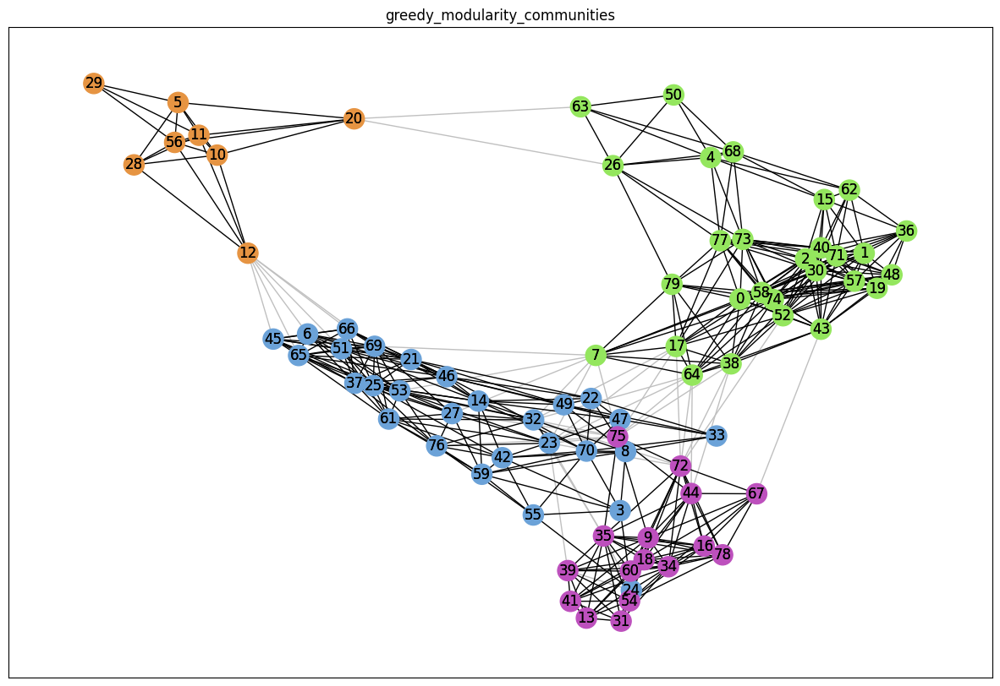

In [121]:
for i in range(len(RGG_communities)):
    # Set node and edge communities
    set_node_community(RGG, RGG_communities[i][1])
    set_edge_community(RGG)
    node_color = [get_color(RGG.nodes[v]['community']) for v in RGG.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in RGG.edges if RGG.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in RGG.edges if RGG.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    RGG_pos = nx.spring_layout(RGG)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        RGG,
        pos=RGG_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        RGG,
        pos=RGG_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(RGG_communities[i][0])  

    # show each graph separately
    plt.show()

#### Οπτικοποίηση κοινοτήτων SW

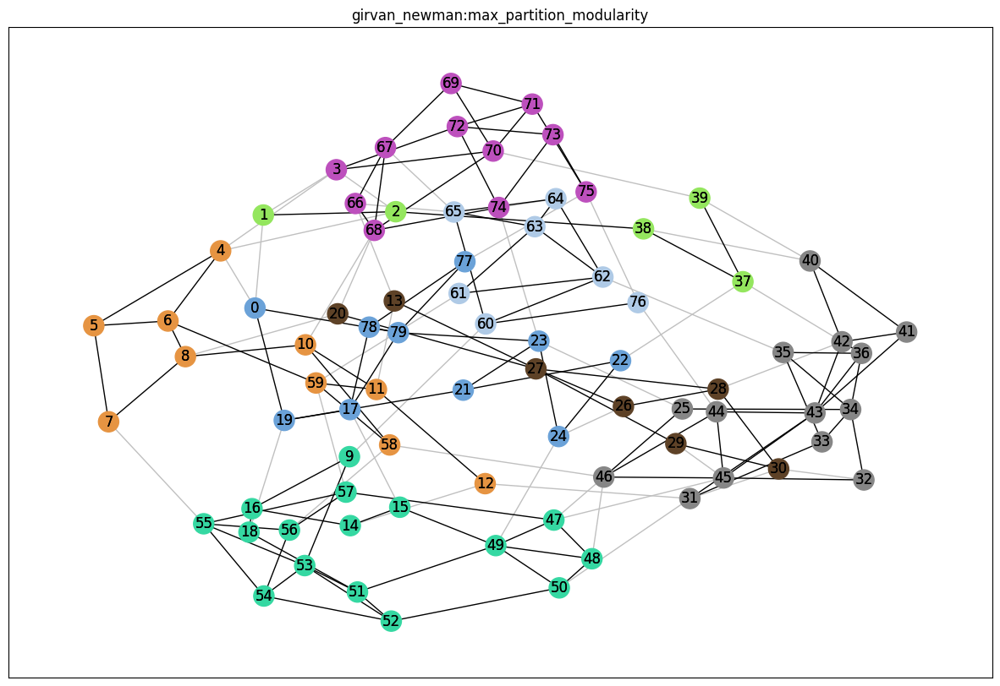

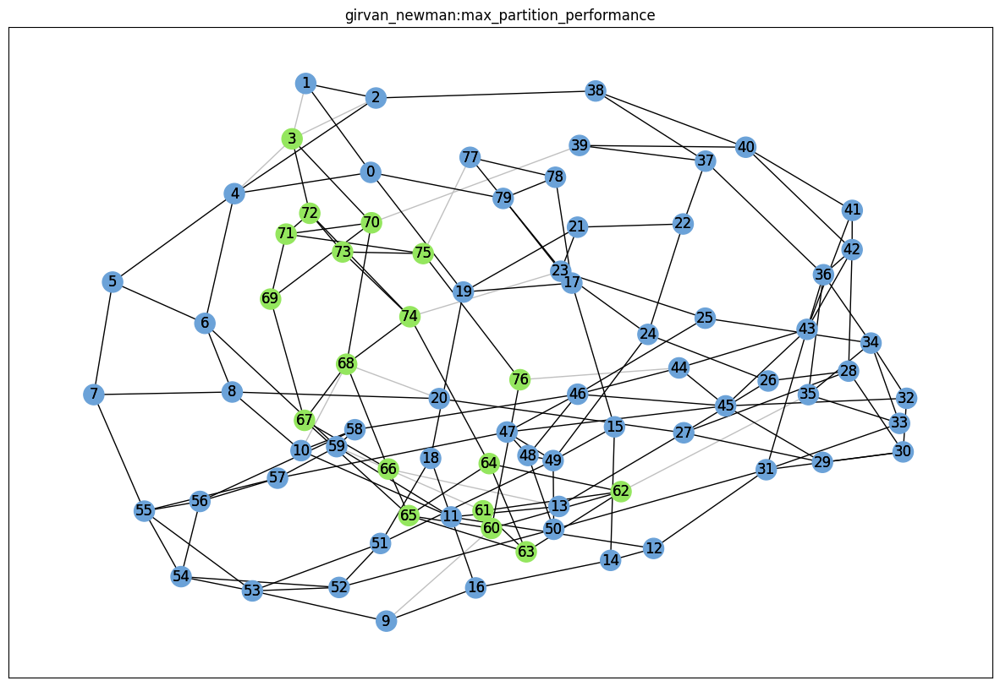

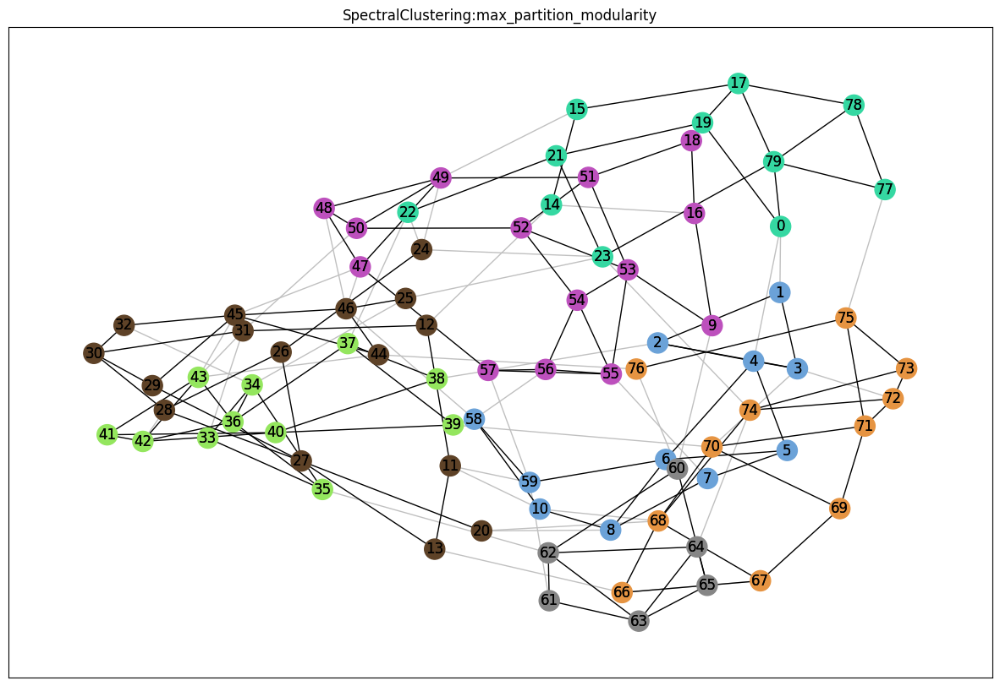

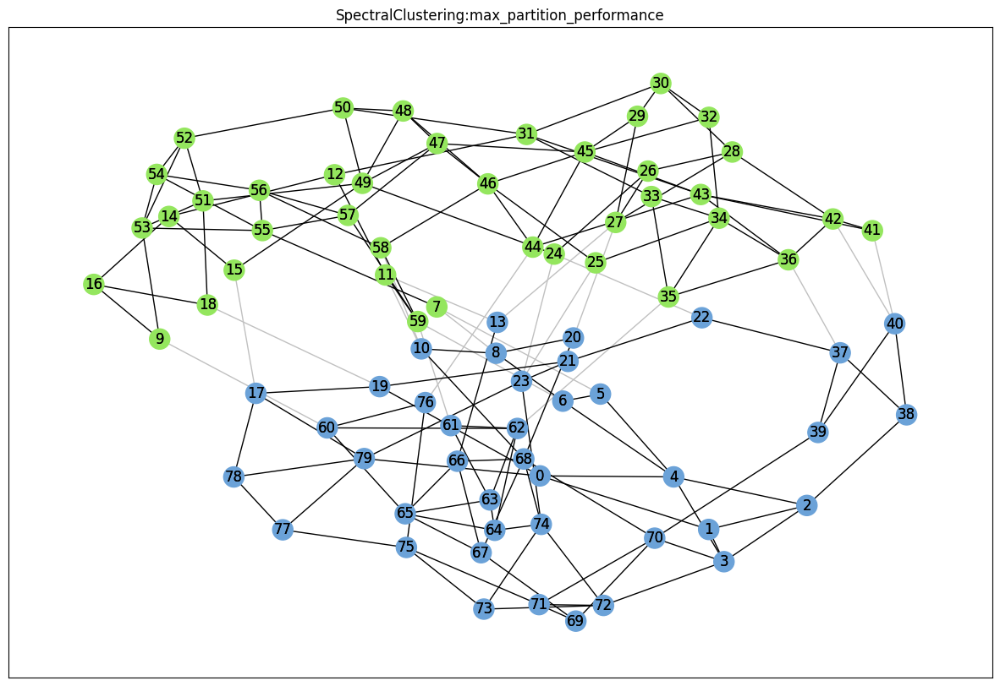

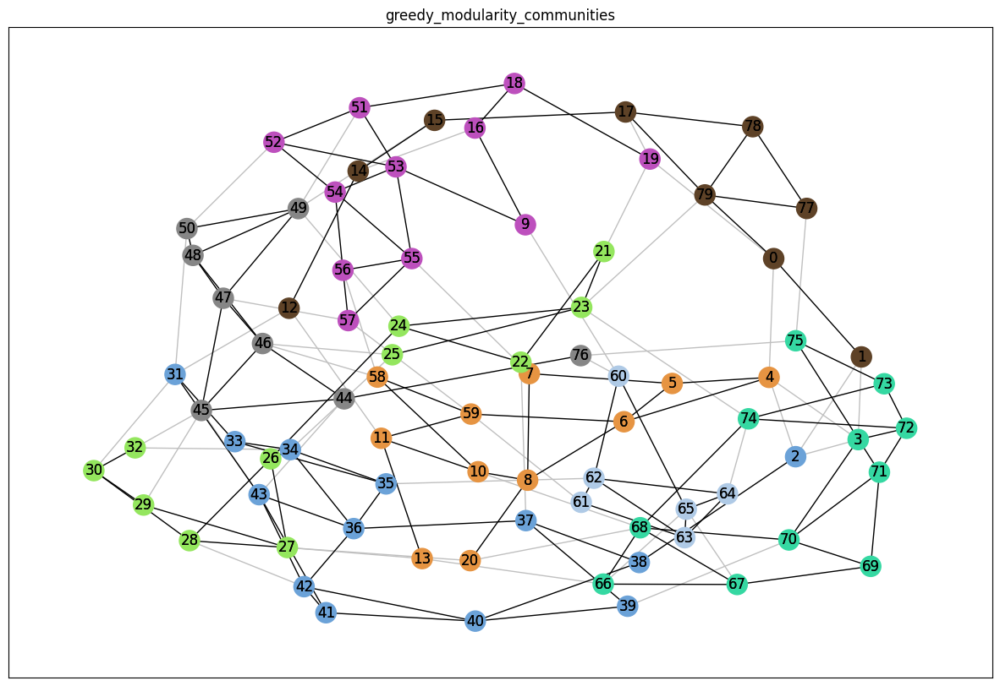

In [122]:
for i in range(len(SW_communities)):
    # Set node and edge communities
    set_node_community(SW, SW_communities[i][1])
    set_edge_community(SW)
    node_color = [get_color(SW.nodes[v]['community']) for v in SW.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in SW.edges if SW.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in SW.edges if SW.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    SW_pos = nx.spring_layout(SW)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        SW,
        pos=SW_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        SW,
        pos=SW_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(SW_communities[i][0])  

    # show each graph separately
    plt.show()

#### Οπτικοποίηση κοινοτήτων SF

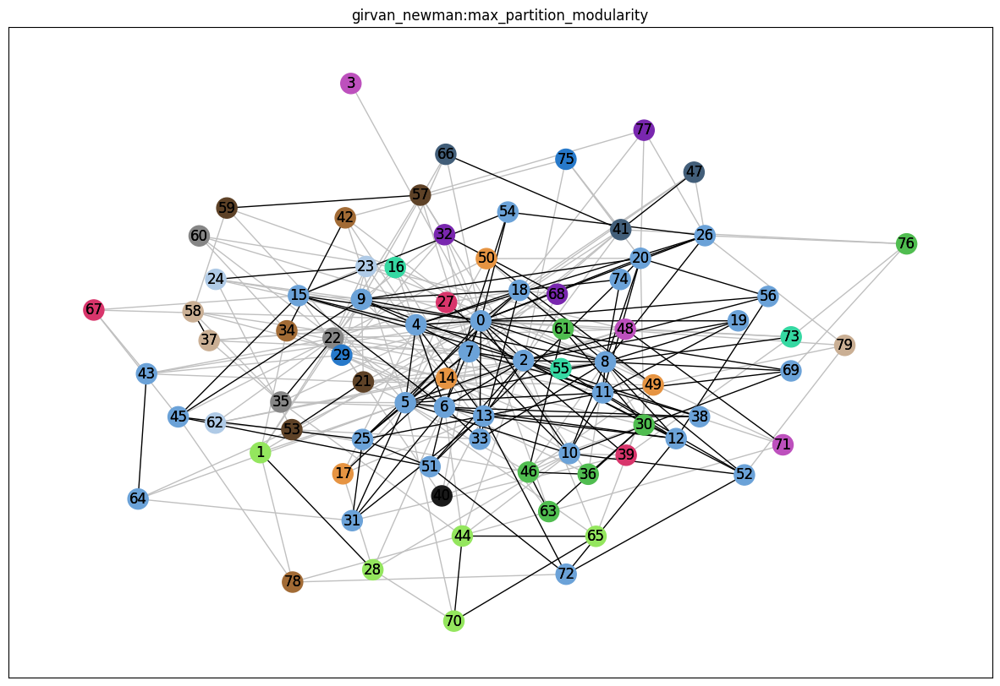

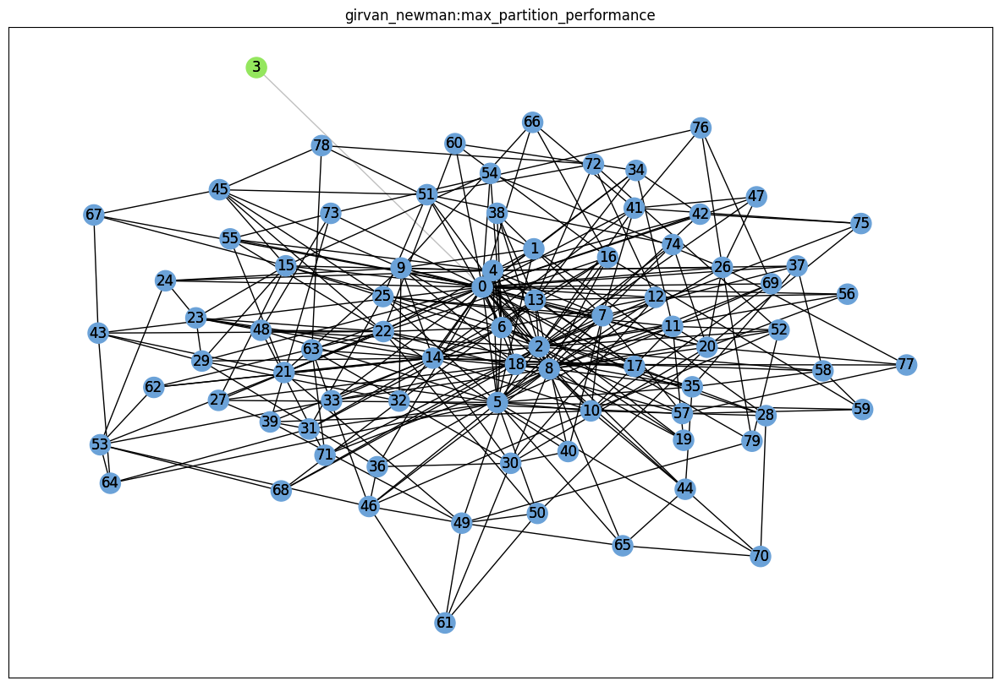

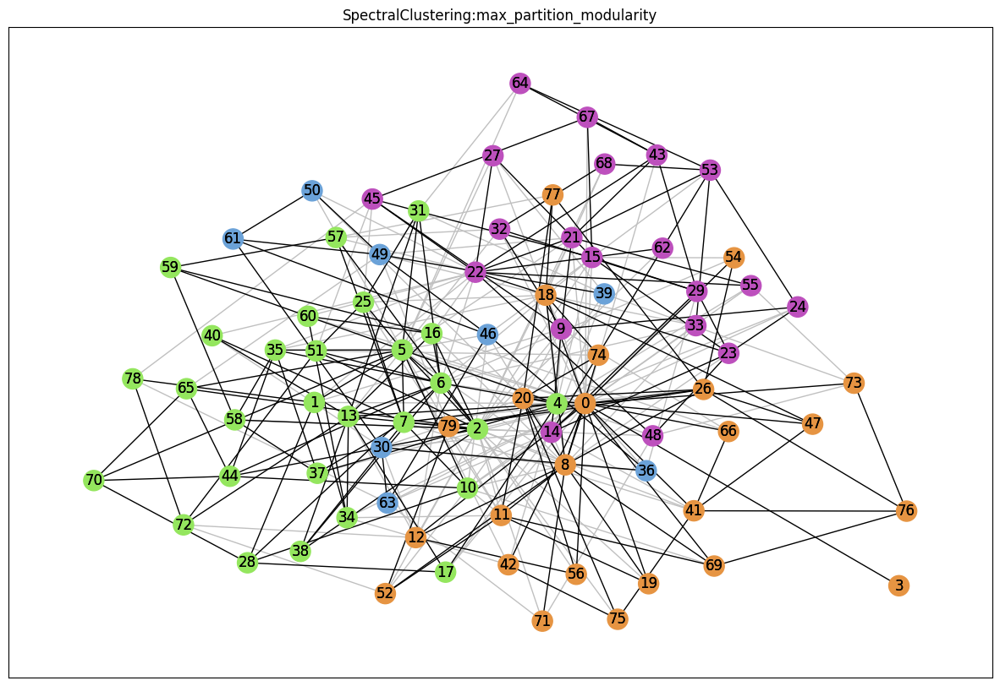

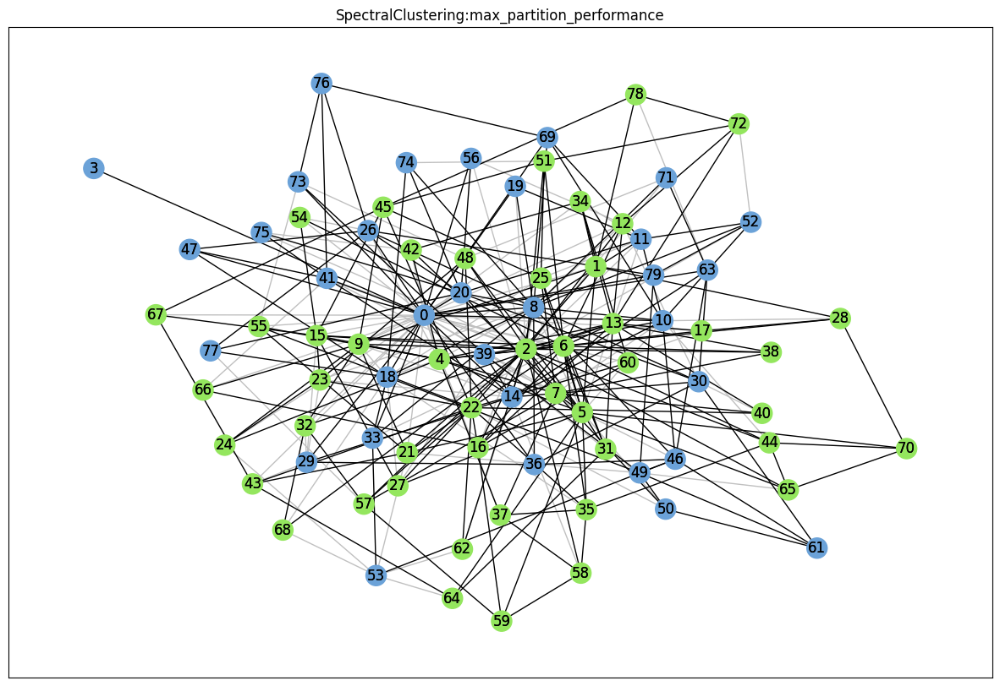

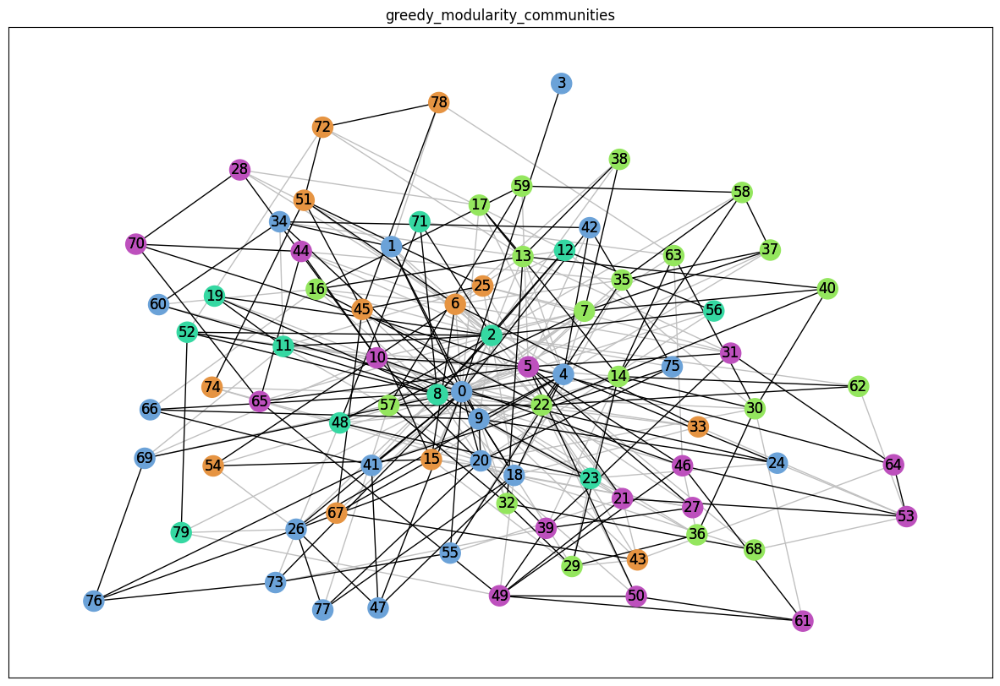

In [123]:
# do the samne for SF_communities
for i in range(len(SF_communities)):
    # Set node and edge communities
    set_node_community(SF, SF_communities[i][1])
    set_edge_community(SF)
    node_color = [get_color(SF.nodes[v]['community']) for v in SF.nodes]
    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in SF.edges if SF.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in SF.edges if SF.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    SF_pos = nx.spring_layout(SF)
    plt.rcParams.update({'figure.figsize': (15, 10)})
    # Draw external edges
    nx.draw_networkx(
        SF,
        pos=SF_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        SF,
        pos=SF_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    # create a title for the graph
    plt.title(SF_communities[i][0])  

    # show each graph separately
    plt.show()

In [124]:

# create function that given node checks if belongs to eu
def is_eu(node):
    if int(node) in eu.nodes:
        return True
    else:
        return False


number_of_communities = 0
with open('./datasets/email-Eu-core-department-labels.txt') as f:
    lines = f.readlines()
    for line in lines:
        # read node community from each line
        node, community = line.split()
        if is_eu(node) is True:
            if int(community) > number_of_communities:
                number_of_communities = int(community)
        
    # create a tuple with sets with number is equal to number of communities
    eu_ground_truth_partition = tuple([set() for i in range(number_of_communities)])
    for line in lines:
        node, community = line.split()
        if is_eu(node) is True:
            eu_ground_truth_partition[int(community) - 1].add(int(node))

    # create a tuple with a name GROUND TRUTH and the eu_ground_truth_partition
    eu_ground_truth = ('ground_truth_partition', eu_ground_truth_partition)
    
    # append the eu_ground_truth to the list of eu_communities
    if eu_ground_truth not in eu_communities:
        eu_communities.append(eu_ground_truth)


import pandas as pd

# initialize the dataframes with the columns
df = pd.DataFrame(columns=['Modularity', 'Performance','#communities'])

# loop through eu_communities and calculate the modularity score and performance score and number of communities
for i in range(len(eu_communities)):
    # calculate modularity score
    modularity_score = nx.algorithms.community.modularity(eu, eu_communities[i][1])
    # calculate performance score
    performance_score = nx.algorithms.community.partition_quality(eu, eu_communities[i][1])[1]
    # calculate number of communities
    number_of_communities = len(eu_communities[i][1])
    
    df.loc[eu_communities[i][0]] = [modularity_score, performance_score, number_of_communities]

      
from IPython.display import Markdown as md

# display the results of the classifiers in a markdown table
markDownTableResults = df.to_markdown()
md(markDownTableResults)


|                                              |   Modularity |   Performance |   #communities |
|:---------------------------------------------|-------------:|--------------:|---------------:|
| girvan_newman:max_partition_modularity       |  0.000621882 |      0.045156 |              2 |
| girvan_newman:max_partition_performance      |  0.000621882 |      0.045156 |              2 |
| SpectralClustering:max_partition_modularity  |  0.383077    |      0.799292 |             11 |
| SpectralClustering:max_partition_performance |  0.0990702   |      0.186534 |              2 |
| greedy_modularity_communities                |  0.347133    |      0.707872 |              8 |
| ground_truth_partition                       |  0.190097    |      0.936024 |             41 |

### Result Analysis

- **Question 1:**  

    REG: The number of communities between the different algorithms keeps the same. Also we can see that the communities are well structured because there is no overlapping between them.
    <br/>
    
    RGER: The community detection algorithms do not give very good results. From the above graphs we can see that the communities are not well defined and there is a lot of overlapping between them. Comparing to the other synthetic networks, this one has the least accurate community detection.
    <br/>

    RGG: All the algorithms give approximately the same number of communities. The communities are very well defined and there is no overlapping between them. It seems to be the most structured network among all the synthetic ones.
    <br/>

    SW: The number of communities between the different algorithms keeps the same. Also we can see from the numerical values provided above that the number of communities for each algorithm matches the one for the REG network.
    <br/>

    SF: As we can see from the graph of Maximum Modularity above, there is no clear partition in this network. This is what we expected because the algorithm many times gives local maximum and not the global one. From Girvan's Newman partition we can see a lot of overlapping between the communities. In general terms the partitions between all the algorithms do not follow a similar structure, some of them are more structured than others.
    <br/>
    
    eu: The eu network has a very small number of communities when the community detection algorithm is the Girvan's Newman. The other algorithms give a much higher number of communities.
    <br/>
    
    football: This network has the biggest number of communities comparing to all the other real world networks. The football network is much less structured than the got network, with tha last one having a very clear partition.
    <br/>
    
    got: This network is very dense and has a very clear partition with no overlapping between the communities. The number of communities is the same for all the algorithms. 


 
- **Question 2:** For all different algorithms Scale free network had pretty low performance and modularity metrics, so we can say that the partitions of this newtork are not that good. Also the RGER network had low modularity score for all algorithms. All the other networks had quite descent performance and modularity scores for all algorithms. It is interesting to say that all algorithms gave approximately the same scores for all algorithms.

- **Question 3:**  From the tables above we can easily see that the ground truth partition has by far better   performance metrics comparing to all other partitions. Girvan's Newman partitions have the worst performance and modularity scores. As about the Spectral's Clustering and Modularity's Maximization partitions, we can see that both have considerable high metrics comparing to Girvan's Newman. 

- **Question 4:**  The most suitable topology for the comparison of runtimes for each algorithm is the eu. Because of the size of the graph, we can say with more confidence some conclusions about the algorithms. As we can see from the tables above, the running time of Girvan Newman was the highest with 224.864 sec, for the Spectral Clustering was 44.7235 sec and for the Modularity Maximization was 2.9678 sec. The Modularity Maximization algorithm had the minimun running time because it is a greedy algorithm and most of the times ends up finding a local optimum. The Girvan Newman is a brute force algorithm, so it takes a lot of time to find the optimal solution. Despite of the fact that Girvan Newman should give the maximum modularity score, it is not the case. The Modularity Maximization and Spectral Clustering algorithms gave the highest modularity score but Modularity Maximization is not a reliable algorithm because it is a greedy algorithm and it does not always find the global optimum. In conclusion, the best algorithm for our task is the Spectral Clustering because it has the highest modularity score and also the second lowest running time.



